In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
df=pd.read_csv('/Users/nikosathanasopoulos/Documents/udemy-ML/housing_train.csv')
df.head()

,id,url,region,region_url,price,type,sqfeet,beds,baths,cats_allowed,...,wheelchair_access,electric_vehicle_charge,comes_furnished,laundry_options,parking_options,image_url,description,lat,long,state
0,7039061606,https://bham.craigslist.org/apa/d/birmingham-h...,birmingham,https://bham.craigslist.org,1195,apartment,1908,3,2.0,1,...,0,0,0,laundry on site,street parking,https://images.craigslist.org/00L0L_80pNkyDeG0...,Apartments In Birmingham AL Welcome to 100 Inv...,33.4226,-86.7065,al
1,7041970863,https://bham.craigslist.org/apa/d/birmingham-w...,birmingham,https://bham.craigslist.org,1120,apartment,1319,3,2.0,1,...,0,0,0,laundry on site,off-street parking,https://images.craigslist.org/00707_uRrY9CsNMC...,Find Your Way to Haven Apartment Homes Come ho...,33.3755,-86.8045,al
2,7041966914,https://bham.craigslist.org/apa/d/birmingham-g...,birmingham,https://bham.craigslist.org,825,apartment,1133,1,1.5,1,...,0,0,0,laundry on site,street parking,https://images.craigslist.org/00h0h_b7Bdj1NLBi...,Apartments In Birmingham AL Welcome to 100 Inv...,33.4226,-86.7065,al
3,7041966936,https://bham.craigslist.org/apa/d/birmingham-f...,birmingham,https://bham.craigslist.org,800,apartment,927,1,1.0,1,...,0,0,0,laundry on site,street parking,https://images.craigslist.org/00808_6ghZ8tSRQs...,Apartments In Birmingham AL Welcome to 100 Inv...,33.4226,-86.7065,al
4,7041966888,https://bham.craigslist.org/apa/d/birmingham-2...,birmingham,https://bham.craigslist.org,785,apartment,1047,2,1.0,1,...,0,0,0,laundry on site,street parking,https://images.craigslist.org/00y0y_21c0FOvUXm...,Apartments In Birmingham AL Welcome to 100 Inv...,33.4226,-86.7065,al


In [3]:
df.shape

(265190, 22)

## Handling Missing values

In [4]:
df.isnull().sum()

id                             0
url                            0
region                         0
region_url                     0
price                          0
type                           0
sqfeet                         0
beds                           0
baths                          0
cats_allowed                   0
dogs_allowed                   0
smoking_allowed                0
wheelchair_access              0
electric_vehicle_charge        0
comes_furnished                0
laundry_options            54311
parking_options            95135
image_url                      0
description                    2
lat                         1419
long                        1419
state                          1
dtype: int64

### lat & long missing values

In [5]:
## remove those rows wherever we have lat & long as missing value

df.dropna(axis='index',how='all', subset=['lat','long'],inplace=True)

In [6]:
df.shape

(263771, 22)

In [7]:
df.isnull().sum()

id                             0
url                            0
region                         0
region_url                     0
price                          0
type                           0
sqfeet                         0
beds                           0
baths                          0
cats_allowed                   0
dogs_allowed                   0
smoking_allowed                0
wheelchair_access              0
electric_vehicle_charge        0
comes_furnished                0
laundry_options            54127
parking_options            94444
image_url                      0
description                    2
lat                            0
long                           0
state                          0
dtype: int64

### laundry_options & parking_options missing values

- 1. Drop those rows wherever we have missing values, but thats not a professional approach
- 2. Fill missing values with Statistical Approaches like Mean , Median & Mode (In case of categorical),but if we have more missing values it will affect distribution of data
- 3. Professional way is -- fill missing values in such a way that it did not affect distribution of that feature, ie using some advanced approaches like <b>Random Value Imputation</b>

#### Fill missing values with Statistical Approaches

In [8]:
data=df.copy()

In [9]:
data['laundry_options'].isnull().sum()

54127

<AxesSubplot: >

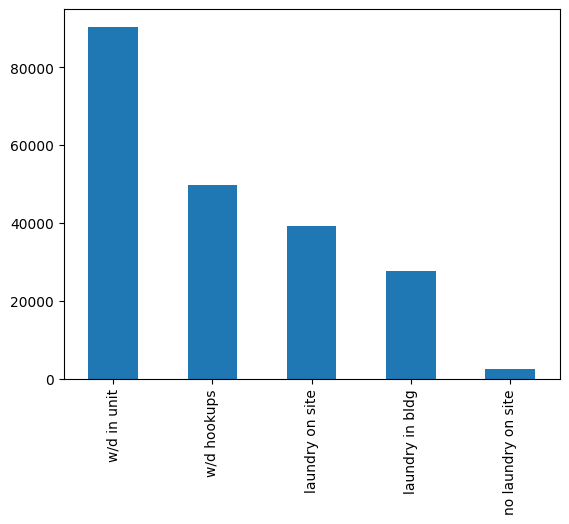

In [10]:
data['laundry_options'].value_counts().plot(kind='bar')

In [11]:
data['laundry_options'].mode()[0]

'w/d in unit'

In [12]:
data['laundry_options'].fillna('w/d in unit',inplace=True)

<AxesSubplot: >

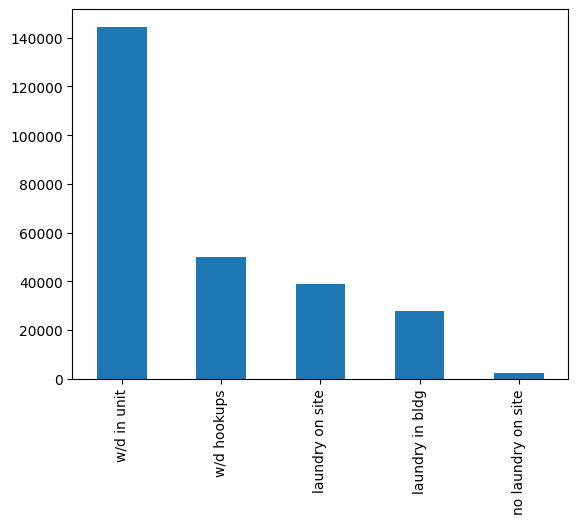

In [13]:
data['laundry_options'].value_counts().plot(kind='bar')

This approach has the disadvantage that changes the ratio of the categories. It means we cant use this approach, as it will impact distribution of data, lets use some smart approaches

### Random Value Imputation

#### to fill laundry_options NA values

#### Random Sample Imputation
Aim: Random sample imputation consists of taking random observation from the dataset and we use this observation to replace the nan values

When should it be used? It assumes that the data are missing completely at random(MCAR)

In [14]:
df['laundry_options'].isnull().sum()

54127

In [15]:
random_sample=df['laundry_options'].dropna().sample(54127)

In [16]:
random_sample

39576         w/d in unit
208071        w/d in unit
200313        w/d in unit
172736        w/d in unit
137746        w/d hookups
               ...       
144629    laundry in bldg
135831    laundry on site
209866        w/d in unit
65956     laundry on site
163526        w/d hookups
Name: laundry_options, Length: 54127, dtype: object

In [17]:
random_sample.index

Int64Index([ 39576, 208071, 200313, 172736, 137746,   1253,  66904, 258578,
            238839,  46447,
            ...
            217257,  32440,  73916,  89429,   3229, 144629, 135831, 209866,
             65956, 163526],
           dtype='int64', length=54127)

In [18]:
df[df['laundry_options'].isnull()].index

Int64Index([    10,     49,     62,     64,     65,     73,     77,     78,
                79,    101,
            ...
            265112, 265121, 265124, 265130, 265136, 265157, 265161, 265163,
            265174, 265187],
           dtype='int64', length=54127)

In [19]:
random_sample.index=df[df['laundry_options'].isnull()].index

In [20]:
random_sample.index

Int64Index([    10,     49,     62,     64,     65,     73,     77,     78,
                79,    101,
            ...
            265112, 265121, 265124, 265130, 265136, 265157, 265161, 265163,
            265174, 265187],
           dtype='int64', length=54127)

In [21]:
df.loc[df['laundry_options'].isnull(), 'laundry_options']=random_sample

In [22]:
df['laundry_options'].isnull().sum()

0

<AxesSubplot: >

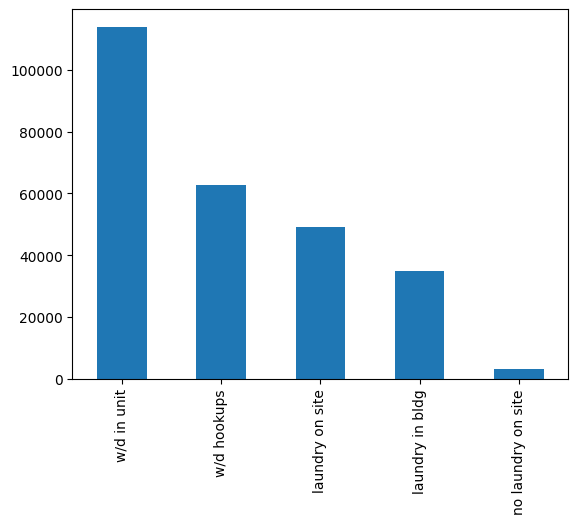

In [23]:
df['laundry_options'].value_counts().plot(kind='bar')

In [24]:
#### Automate above stuffs
def impute_nan(df,variable):
    ##It will have the random sample to fill the na

    random_sample=df[variable].dropna().sample(df[variable].isnull().sum())
    
    ##pandas need to have equal index in order to merge the dataset
    random_sample.index=df[df[variable].isnull()].index
    df.loc[df[variable].isnull(),variable]=random_sample


#### impute NA Values of parking_options

In [25]:
df['parking_options'].isnull().sum()

94444

In [26]:
df['parking_options'].value_counts()/len(df)*100

off-street parking    33.399805
carport               10.848046
attached garage       10.316145
detached garage        4.838667
street parking         4.000061
no parking             0.745723
valet parking          0.046252
Name: parking_options, dtype: float64

In [27]:
## initial ratio between off-street parking & Carport
33/10

3.3

In [28]:
## imputing NaNs of parking_options
impute_nan(df,'parking_options')

In [29]:
## After imputing NaNs, lets check the ratio between off-street parking & Carport
52/16

3.25

In [30]:
df['parking_options'].value_counts()/len(df)*100

off-street parking    52.058793
carport               16.900266
attached garage       16.057868
detached garage        7.514473
street parking         6.249360
no parking             1.147586
valet parking          0.071653
Name: parking_options, dtype: float64

In [31]:
df['parking_options'].isnull().sum()

0

In [32]:
df.head()

,id,url,region,region_url,price,type,sqfeet,beds,baths,cats_allowed,...,wheelchair_access,electric_vehicle_charge,comes_furnished,laundry_options,parking_options,image_url,description,lat,long,state
0,7039061606,https://bham.craigslist.org/apa/d/birmingham-h...,birmingham,https://bham.craigslist.org,1195,apartment,1908,3,2.0,1,...,0,0,0,laundry on site,street parking,https://images.craigslist.org/00L0L_80pNkyDeG0...,Apartments In Birmingham AL Welcome to 100 Inv...,33.4226,-86.7065,al
1,7041970863,https://bham.craigslist.org/apa/d/birmingham-w...,birmingham,https://bham.craigslist.org,1120,apartment,1319,3,2.0,1,...,0,0,0,laundry on site,off-street parking,https://images.craigslist.org/00707_uRrY9CsNMC...,Find Your Way to Haven Apartment Homes Come ho...,33.3755,-86.8045,al
2,7041966914,https://bham.craigslist.org/apa/d/birmingham-g...,birmingham,https://bham.craigslist.org,825,apartment,1133,1,1.5,1,...,0,0,0,laundry on site,street parking,https://images.craigslist.org/00h0h_b7Bdj1NLBi...,Apartments In Birmingham AL Welcome to 100 Inv...,33.4226,-86.7065,al
3,7041966936,https://bham.craigslist.org/apa/d/birmingham-f...,birmingham,https://bham.craigslist.org,800,apartment,927,1,1.0,1,...,0,0,0,laundry on site,street parking,https://images.craigslist.org/00808_6ghZ8tSRQs...,Apartments In Birmingham AL Welcome to 100 Inv...,33.4226,-86.7065,al
4,7041966888,https://bham.craigslist.org/apa/d/birmingham-2...,birmingham,https://bham.craigslist.org,785,apartment,1047,2,1.0,1,...,0,0,0,laundry on site,street parking,https://images.craigslist.org/00y0y_21c0FOvUXm...,Apartments In Birmingham AL Welcome to 100 Inv...,33.4226,-86.7065,al


In [33]:
df.columns

Index(['id', 'url', 'region', 'region_url', 'price', 'type', 'sqfeet', 'beds',
       'baths', 'cats_allowed', 'dogs_allowed', 'smoking_allowed',
       'wheelchair_access', 'electric_vehicle_charge', 'comes_furnished',
       'laundry_options', 'parking_options', 'image_url', 'description', 'lat',
       'long', 'state'],
      dtype='object')

## Perform Text Analysis on Description feature

### Wordcloud Analysis

In [34]:
#!pip install wordcloud

In [35]:
from wordcloud import WordCloud, STOPWORDS

In [36]:
total_description=''

In [37]:
stopwords=set(STOPWORDS)

In [38]:
# iterate through the first 10k rows of dataframe..
for val in df['description'][0:10000]:
    # typecaste each val to string 
    val = str(val) 
    
    # split the value 
    tokens = val.split() 
    
    # Converts each token into lowercase 
    for i in range(len(tokens)): 
        tokens[i] = tokens[i].lower()
        
    total_description = total_description + " ".join(tokens)+" "

/var/folders/qz/f43xldgd339f63pl19dqgt9w0000gn/T/ipykernel_41647/1144955418.py:2: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  for val in df['description'][0:10000]:


In [39]:
### generating your WordCloud
wordcloud = WordCloud(width = 800, height = 800, 
                background_color ='white', 
                stopwords = stopwords, 
                min_font_size = 10).generate(total_description) 

(-0.5, 799.5, 799.5, -0.5)

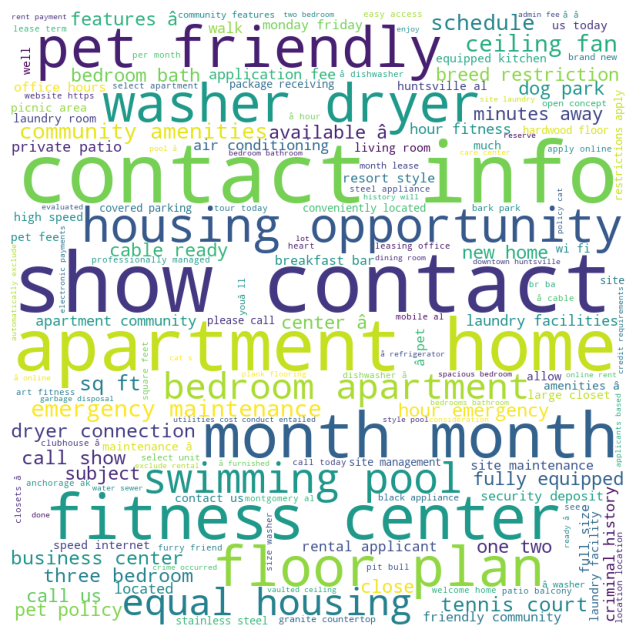

In [40]:
# plot the WordCloud image                        
plt.figure(figsize = (8, 8)) 
plt.imshow(wordcloud) 
plt.axis("off")

### Data Cleaning on Description

1) <b>lowercase</b>
2) <b>remove special characters</b>
3) <b>Remove Stopwords</b>

<b>using nltk!!</b>

#### 1) Lowercase

In [41]:
df['description'].isnull().sum()

2

In [42]:
df['description'].fillna('no description',inplace=True)

In [43]:
df['description'].isnull().sum()

0

In [44]:
def lower(x):
    return x.lower()

In [45]:
#df['description'].apply(lower)

In [46]:
df['description']=df['description'].apply(lambda x: x.lower())

In [47]:
df['description'][0]

'apartments in birmingham al welcome to 100 inverness apartment homes, a luxury apartment community tucked away into one of the most coveted locations in the city for birmingham apartments. find stylish one-, two-, and three-bedroom apartment floor plans tailored to your wants and needs, complete with the amenities that are important to you. our layouts come with just enough variety to enable you to make it your own haven unlike any other. get inspired by our photos and the serenity of the nature surrounding you to let your aesthetic come together with our stylish, modern designs for a home you wonâ\x80\x99t be able to wait to show off to your guests. even beyond style, our pet-friendly apartment community is also all about functionality! some of our homes come with washer and dryer hookups, wood burning fireplaces, hardwood floors, and a private patio or balcony. all of our residents can make use of oversized walk-in closets, air conditioning, garages, a business center, on-site manag

#### 2) Keep only alphabet (remove special characters)

In [48]:
from nltk.corpus import RegexpTokenizer

In [49]:
tokenizer=RegexpTokenizer("[a-zA-Z]+")

In [50]:
tokenizer.tokenize(df['description'][0])

['apartments',
 'in',
 'birmingham',
 'al',
 'welcome',
 'to',
 'inverness',
 'apartment',
 'homes',
 'a',
 'luxury',
 'apartment',
 'community',
 'tucked',
 'away',
 'into',
 'one',
 'of',
 'the',
 'most',
 'coveted',
 'locations',
 'in',
 'the',
 'city',
 'for',
 'birmingham',
 'apartments',
 'find',
 'stylish',
 'one',
 'two',
 'and',
 'three',
 'bedroom',
 'apartment',
 'floor',
 'plans',
 'tailored',
 'to',
 'your',
 'wants',
 'and',
 'needs',
 'complete',
 'with',
 'the',
 'amenities',
 'that',
 'are',
 'important',
 'to',
 'you',
 'our',
 'layouts',
 'come',
 'with',
 'just',
 'enough',
 'variety',
 'to',
 'enable',
 'you',
 'to',
 'make',
 'it',
 'your',
 'own',
 'haven',
 'unlike',
 'any',
 'other',
 'get',
 'inspired',
 'by',
 'our',
 'photos',
 'and',
 'the',
 'serenity',
 'of',
 'the',
 'nature',
 'surrounding',
 'you',
 'to',
 'let',
 'your',
 'aesthetic',
 'come',
 'together',
 'with',
 'our',
 'stylish',
 'modern',
 'designs',
 'for',
 'a',
 'home',
 'you',
 'won',
 't',

In [51]:
sample = df.sample(10000)

In [52]:
sample.head()

,id,url,region,region_url,price,type,sqfeet,beds,baths,cats_allowed,...,wheelchair_access,electric_vehicle_charge,comes_furnished,laundry_options,parking_options,image_url,description,lat,long,state
178257,7043853341,https://westernmass.craigslist.org/apa/d/westf...,western massachusetts,https://westernmass.craigslist.org,1500,apartment,775,2,1.0,1,...,0,0,1,w/d in unit,off-street parking,https://images.craigslist.org/00404_l5QR0CQIcr...,conveniently located within seconds of the mas...,42.1398,-72.7380,ma
76289,7041412389,https://gainesville.craigslist.org/apa/d/gaine...,gainesville,https://gainesville.craigslist.org,939,apartment,1098,3,2.0,1,...,0,0,0,w/d in unit,carport,https://images.craigslist.org/00t0t_epl2tJuxOc...,welcome home to verdant cove apartments in gai...,29.6418,-82.2985,fl
173653,7035068425,https://frederick.craigslist.org/apa/d/frederi...,frederick,https://frederick.craigslist.org,1220,apartment,847,1,1.5,1,...,0,0,0,w/d in unit,detached garage,https://images.craigslist.org/00R0R_3485wWJ4Gm...,welcome to your home at the fields rock creek ...,39.4219,-77.4331,md
27227,7049997191,https://losangeles.craigslist.org/lgb/apa/d/lo...,los angeles,https://losangeles.craigslist.org,1450,apartment,650,1,1.0,0,...,0,0,0,w/d hookups,off-street parking,https://images.craigslist.org/01717_1mAdbVMyrT...,welcome to style and comfort! finding an apart...,33.8427,-118.1760,ca
224602,7045895640,https://raleigh.craigslist.org/apa/d/raleigh-o...,raleigh / durham / CH,https://raleigh.craigslist.org,918,apartment,772,1,1.0,0,...,0,0,0,w/d in unit,off-street parking,https://images.craigslist.org/00s0s_lSYsR5CoZc...,welcome to edgewater on lake lynn! our one bed...,35.8812,-78.6957,nc


In [53]:
sample_tokens=sample['description'].apply(tokenizer.tokenize)

In [54]:
sample_tokens

178257    [conveniently, located, within, seconds, of, t...
76289     [welcome, home, to, verdant, cove, apartments,...
173653    [welcome, to, your, home, at, the, fields, roc...
27227     [welcome, to, style, and, comfort, finding, an...
224602    [welcome, to, edgewater, on, lake, lynn, our, ...
                                ...                        
8261      [very, nice, log, home, on, for, rent, on, acr...
169957    [upgraded, extended, studio, ss, appliances, h...
71901     [located, in, the, heart, of, deland, the, par...
70157     [located, in, the, old, base, housing, neighbo...
205531    [welcome, home, designed, with, comfort, and, ...
Name: description, Length: 10000, dtype: object

In [56]:
print(sample_tokens[8261])

['very', 'nice', 'log', 'home', 'on', 'for', 'rent', 'on', 'acres', 'sqft', 'log', 'home', 'oil', 'furnace', 'with', 'a', 'wood', 'stove', 'supplemental', 'heat', 'with', 'very', 'large', 'lawn', 'for', 'rent', 'month', 'looking', 'responsible', 'mature', 'nonsmoking', 'tenant', 'place', 'has', 'a', 'very', 'large', 'front', 'deck']


#### 3) Remove stopwords (e.g. a, the, to etc)

In [57]:
from nltk.corpus import stopwords

In [58]:
stop=stopwords.words('english')
print(stop)

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own', 'same', 'so', 'than', '

In [61]:
rev=sample_tokens[8261]

In [62]:
print([token for token in rev if token not in stop])

['nice', 'log', 'home', 'rent', 'acres', 'sqft', 'log', 'home', 'oil', 'furnace', 'wood', 'stove', 'supplemental', 'heat', 'large', 'lawn', 'rent', 'month', 'looking', 'responsible', 'mature', 'nonsmoking', 'tenant', 'place', 'large', 'front', 'deck']


In [63]:
updated_text = []

for token in rev:
    if token not in stop:
        updated_text.append(token)

In [64]:
print(updated_text)

['nice', 'log', 'home', 'rent', 'acres', 'sqft', 'log', 'home', 'oil', 'furnace', 'wood', 'stove', 'supplemental', 'heat', 'large', 'lawn', 'rent', 'month', 'looking', 'responsible', 'mature', 'nonsmoking', 'tenant', 'place', 'large', 'front', 'deck']


In [65]:
def remove_stopwords(text):
    updated_text=[token for token in text if token not in stop]
    return updated_text

In [66]:
sample_tokens=sample_tokens.apply(remove_stopwords)

In [67]:
sample_tokens

178257    [conveniently, located, within, seconds, mass,...
76289     [welcome, home, verdant, cove, apartments, gai...
173653    [welcome, home, fields, rock, creek, located, ...
27227     [welcome, style, comfort, finding, apartment, ...
224602    [welcome, edgewater, lake, lynn, one, bedroom,...
                                ...                        
8261      [nice, log, home, rent, acres, sqft, log, home...
169957    [upgraded, extended, studio, ss, appliances, h...
71901     [located, heart, deland, park, capri, minutes,...
70157     [located, old, base, housing, neighborhood, do...
205531    [welcome, home, designed, comfort, convenience...
Name: description, Length: 10000, dtype: object

In [68]:
len(sample_tokens)

10000

In [69]:
type(sample_tokens)

pandas.core.series.Series

In [70]:
indices=[i for i in range(0,10000)]

In [71]:
rev=pd.Series(data=sample_tokens.values,index=indices)
rev

0       [conveniently, located, within, seconds, mass,...
1       [welcome, home, verdant, cove, apartments, gai...
2       [welcome, home, fields, rock, creek, located, ...
3       [welcome, style, comfort, finding, apartment, ...
4       [welcome, edgewater, lake, lynn, one, bedroom,...
                              ...                        
9995    [nice, log, home, rent, acres, sqft, log, home...
9996    [upgraded, extended, studio, ss, appliances, h...
9997    [located, heart, deland, park, capri, minutes,...
9998    [located, old, base, housing, neighborhood, do...
9999    [welcome, home, designed, comfort, convenience...
Length: 10000, dtype: object

In [72]:
print(rev[0])

['conveniently', 'located', 'within', 'seconds', 'mass', 'pike', 'pet', 'friendly', 'community', 'perfect', 'location', 'heart', 'westfield', 'willows', 'features', 'spacious', 'bedroom', 'apartment', 'homes', 'bright', 'open', 'floorplans', 'homes', 'also', 'recently', 'updated', 'move', 'ready', 'newly', 'remodeled', 'apartments', 'willows', 'modern', 'kitchen', 'layout', 'white', 'cabinetry', 'stainless', 'steel', 'appliances', 'including', 'dishwasher', 'microwave', 'spacious', 'closets', 'shelving', 'free', 'heat', 'hot', 'water', 'sewer', 'trash', 'landscaping', 'snow', 'removal', 'rubbish', 'sewage', 'removal', 'large', 'breakfast', 'nook', 'better', 'yet', 'check', 'amazing', 'amenities', 'pet', 'friendly', 'large', 'breeds', 'welcome', 'dog', 'park', 'hour', 'emergency', 'maintenance', 'beautiful', 'landscaped', 'community', 'site', 'leasing', 'office', 'resident', 'events', 'call', 'text', 'today', 'call', 'email', 'willows', 'apartments', 'today', 'set', 'personal', 'tour', 

In [73]:
# Concatenating all the reviews as I have to count frequency of each word as I have to plot which word has highest count
all_descriptions=sample_tokens.astype(str).str.cat()

In [74]:
type(all_descriptions)

str

In [75]:
all_descriptions

"['conveniently', 'located', 'within', 'seconds', 'mass', 'pike', 'pet', 'friendly', 'community', 'perfect', 'location', 'heart', 'westfield', 'willows', 'features', 'spacious', 'bedroom', 'apartment', 'homes', 'bright', 'open', 'floorplans', 'homes', 'also', 'recently', 'updated', 'move', 'ready', 'newly', 'remodeled', 'apartments', 'willows', 'modern', 'kitchen', 'layout', 'white', 'cabinetry', 'stainless', 'steel', 'appliances', 'including', 'dishwasher', 'microwave', 'spacious', 'closets', 'shelving', 'free', 'heat', 'hot', 'water', 'sewer', 'trash', 'landscaping', 'snow', 'removal', 'rubbish', 'sewage', 'removal', 'large', 'breakfast', 'nook', 'better', 'yet', 'check', 'amazing', 'amenities', 'pet', 'friendly', 'large', 'breeds', 'welcome', 'dog', 'park', 'hour', 'emergency', 'maintenance', 'beautiful', 'landscaped', 'community', 'site', 'leasing', 'office', 'resident', 'events', 'call', 'text', 'today', 'call', 'email', 'willows', 'apartments', 'today', 'set', 'personal', 'tour',

In [76]:
## perform tokenization to convert your string(all_descriptions) into list,so that we will count frequency of words
cleaned_reviews=tokenizer.tokenize(all_descriptions)

In [77]:
type(cleaned_reviews)

list

In [78]:
len(cleaned_reviews)

1214986

In [79]:
print(cleaned_reviews[0:100])

['conveniently', 'located', 'within', 'seconds', 'mass', 'pike', 'pet', 'friendly', 'community', 'perfect', 'location', 'heart', 'westfield', 'willows', 'features', 'spacious', 'bedroom', 'apartment', 'homes', 'bright', 'open', 'floorplans', 'homes', 'also', 'recently', 'updated', 'move', 'ready', 'newly', 'remodeled', 'apartments', 'willows', 'modern', 'kitchen', 'layout', 'white', 'cabinetry', 'stainless', 'steel', 'appliances', 'including', 'dishwasher', 'microwave', 'spacious', 'closets', 'shelving', 'free', 'heat', 'hot', 'water', 'sewer', 'trash', 'landscaping', 'snow', 'removal', 'rubbish', 'sewage', 'removal', 'large', 'breakfast', 'nook', 'better', 'yet', 'check', 'amazing', 'amenities', 'pet', 'friendly', 'large', 'breeds', 'welcome', 'dog', 'park', 'hour', 'emergency', 'maintenance', 'beautiful', 'landscaped', 'community', 'site', 'leasing', 'office', 'resident', 'events', 'call', 'text', 'today', 'call', 'email', 'willows', 'apartments', 'today', 'set', 'personal', 'tour', 

#### FreqDist, Bigrams, Trigrams (frequency of words)

In [80]:
# obtain the frequency of individual words in the reviews, for this u have to use FreqDist

In [81]:
from nltk import FreqDist, bigrams, trigrams

In [82]:
# Frequency distribution
fd = FreqDist()

In [83]:
for word in cleaned_reviews:
    fd[word]=fd[word]+1 #fd[word]+=1

In [84]:
# Examining the top 5 most frequent words
fd.most_common(5)

[('community', 11270),
 ('contact', 11096),
 ('apartment', 10564),
 ('apartments', 9929),
 ('info', 9300)]

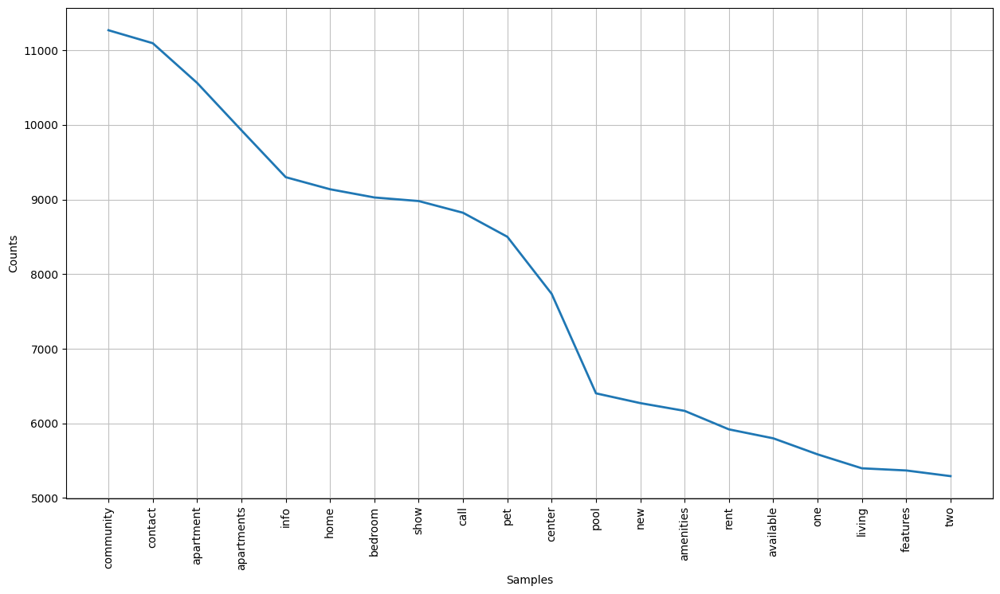

<AxesSubplot: xlabel='Samples', ylabel='Counts'>

In [85]:
# Plotting the top 50 most frequent words
plt.figure(figsize = (15, 8))
fd.plot(20)

#### Bi-grams (sequence of  words)

In [86]:
from nltk import bigrams

In [87]:
fd_bigrams=FreqDist()

In [88]:
bigrams=bigrams(cleaned_reviews)

In [89]:
for bigram in bigrams:
    fd_bigrams[bigram]=fd_bigrams[bigram]+1

In [90]:
fd_bigrams.most_common(5)

[(('contact', 'info'), 8859),
 (('show', 'contact'), 8638),
 (('washer', 'dryer'), 4520),
 (('fitness', 'center'), 4036),
 (('call', 'show'), 3138)]

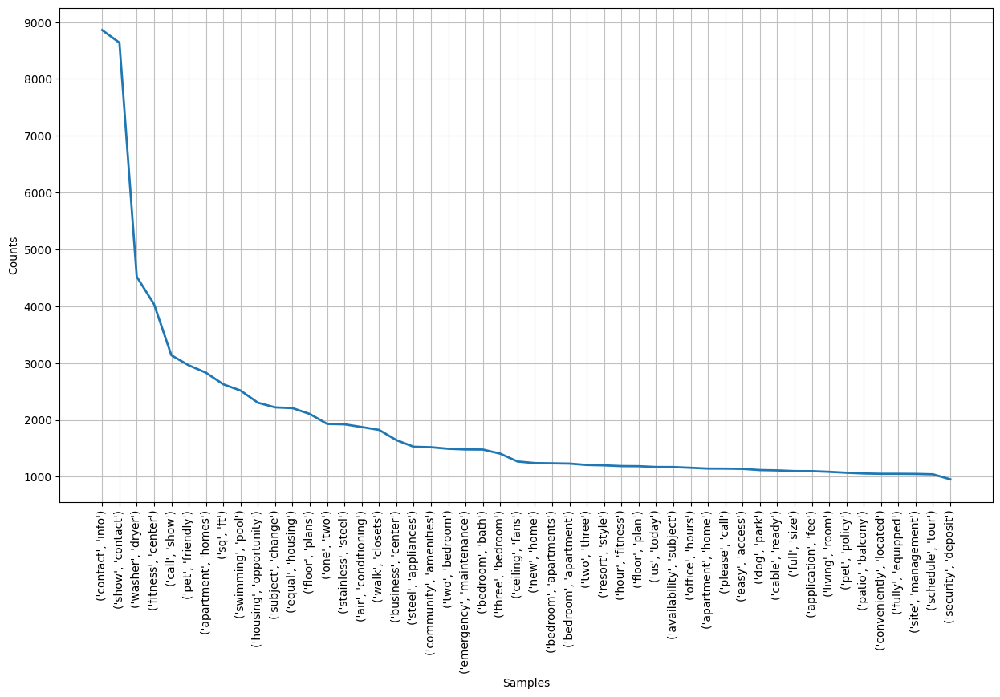

<AxesSubplot: xlabel='Samples', ylabel='Counts'>

In [91]:
# Plotting the top 50 most frequent bigrams
plt.figure(figsize = (15, 8))
fd_bigrams.plot(50)

#### Tri-grams (sequence of 3 words)

In [92]:
from nltk import trigrams

In [93]:
# Generating trigrams from the reviews
trigrams = trigrams(cleaned_reviews)

In [94]:
fd_trigrams = FreqDist()

for trigram in trigrams:
    fd_trigrams[trigram] += 1

In [95]:
fd_trigrams.most_common(5)

[(('show', 'contact', 'info'), 8638),
 (('call', 'show', 'contact'), 3138),
 (('equal', 'housing', 'opportunity'), 2151),
 (('stainless', 'steel', 'appliances'), 1517),
 (('availability', 'subject', 'change'), 1168)]

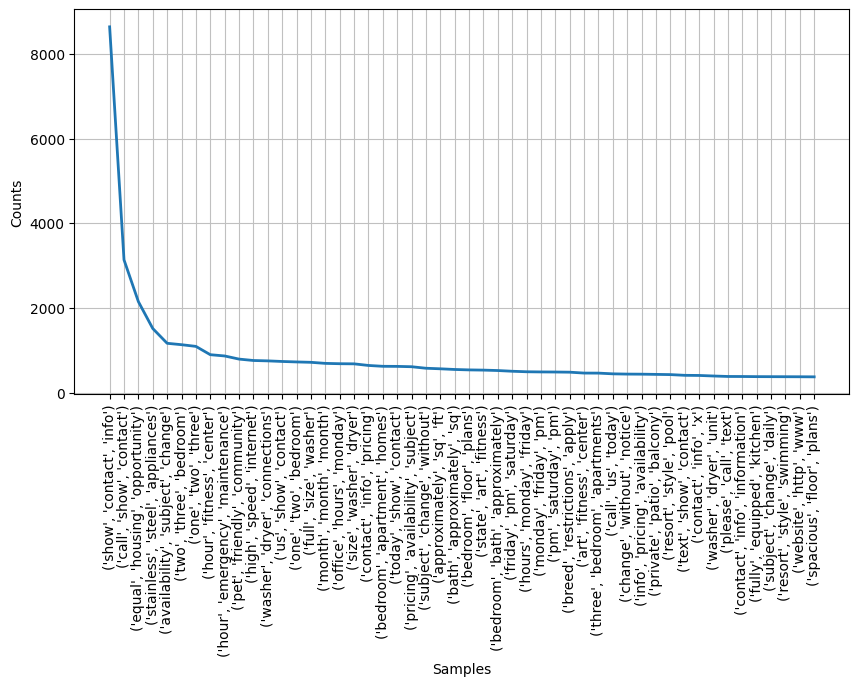

<AxesSubplot: xlabel='Samples', ylabel='Counts'>

In [96]:
plt.figure(figsize = (10, 5))
fd_trigrams.plot(50)

### Geographical Spatial Analysis

Perform Geographical Spatial Analysis to understand where exactly higher priced houses are situated.

In [97]:
#!pip install folium

In [98]:
import folium

In [99]:
from folium.plugins import HeatMap

In [100]:
df.columns

Index(['id', 'url', 'region', 'region_url', 'price', 'type', 'sqfeet', 'beds',
       'baths', 'cats_allowed', 'dogs_allowed', 'smoking_allowed',
       'wheelchair_access', 'electric_vehicle_charge', 'comes_furnished',
       'laundry_options', 'parking_options', 'image_url', 'description', 'lat',
       'long', 'state'],
      dtype='object')

In [101]:
m=folium.Map()
m

In [102]:
HeatMap(data=df[['lat','long','price']],radius=15).add_to(m)

In [103]:
m

### Label Distribution of Data

In [104]:
def label_distribution(feature):
    return sns.countplot(data=df, x=feature)

In [105]:
type(df['beds'])

pandas.core.series.Series

In [106]:
df.columns

Index(['id', 'url', 'region', 'region_url', 'price', 'type', 'sqfeet', 'beds',
       'baths', 'cats_allowed', 'dogs_allowed', 'smoking_allowed',
       'wheelchair_access', 'electric_vehicle_charge', 'comes_furnished',
       'laundry_options', 'parking_options', 'image_url', 'description', 'lat',
       'long', 'state'],
      dtype='object')

In [107]:
df['beds']

0         3
1         3
2         1
3         1
4         2
         ..
265184    1
265185    2
265186    2
265187    2
265188    3
Name: beds, Length: 263771, dtype: int64

In [108]:
list=['beds',
       'baths', 'cats_allowed', 'dogs_allowed', 'smoking_allowed',
       'wheelchair_access', 'electric_vehicle_charge', 'comes_furnished']

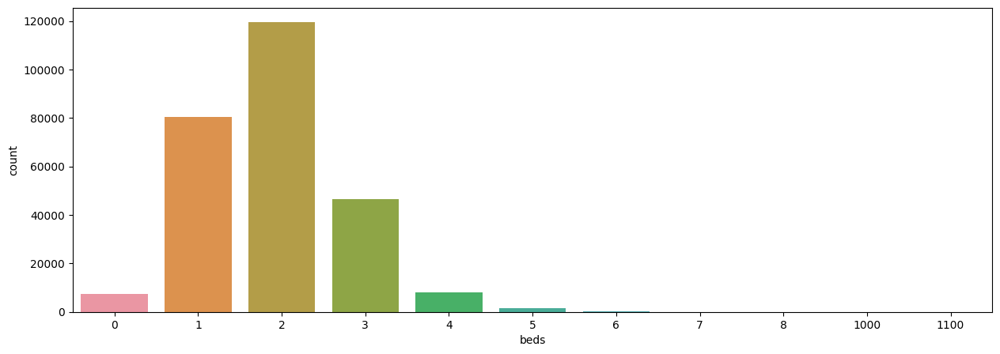

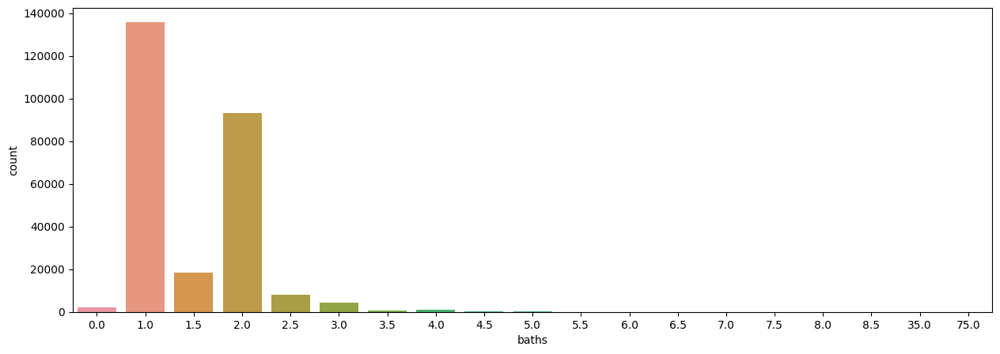

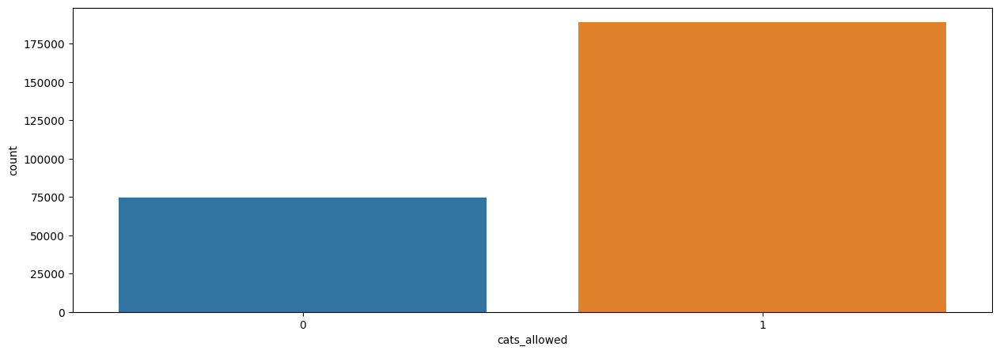

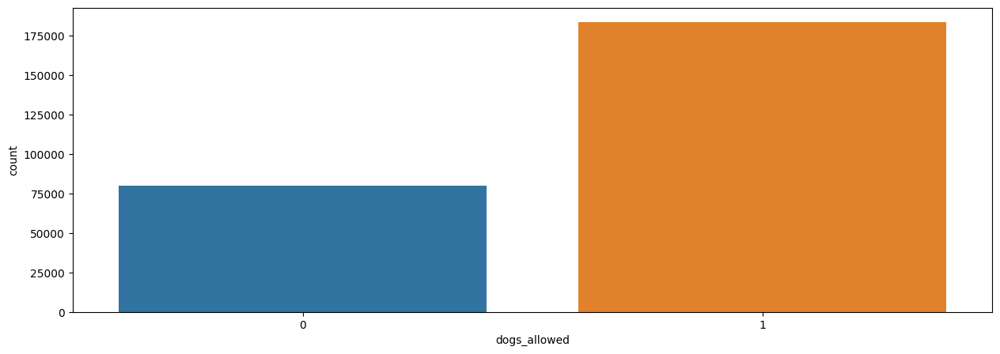

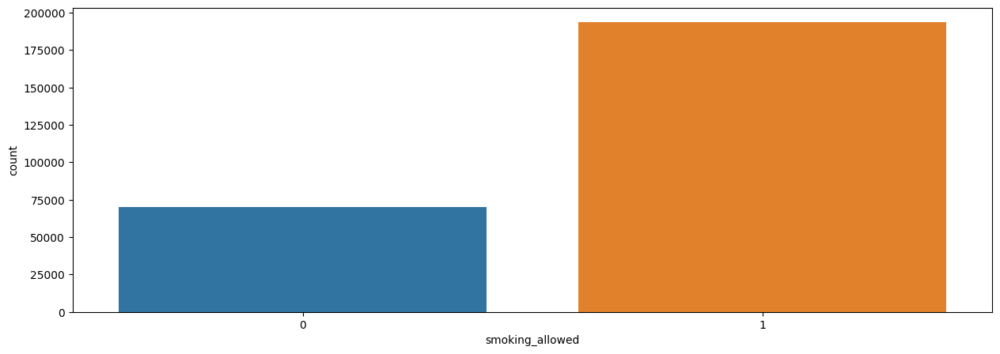

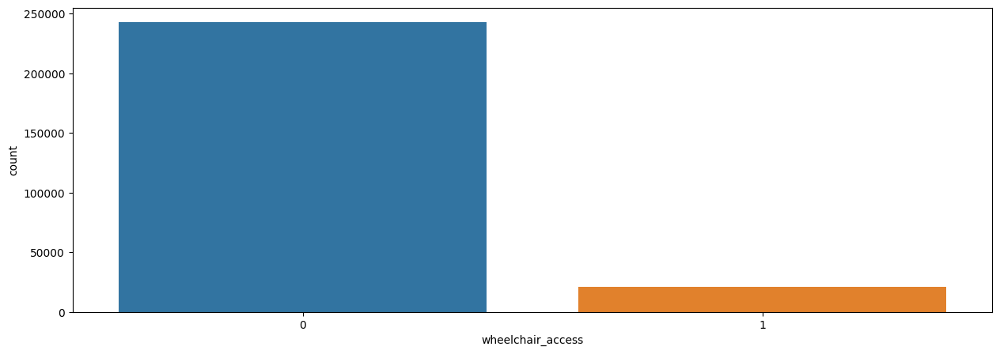

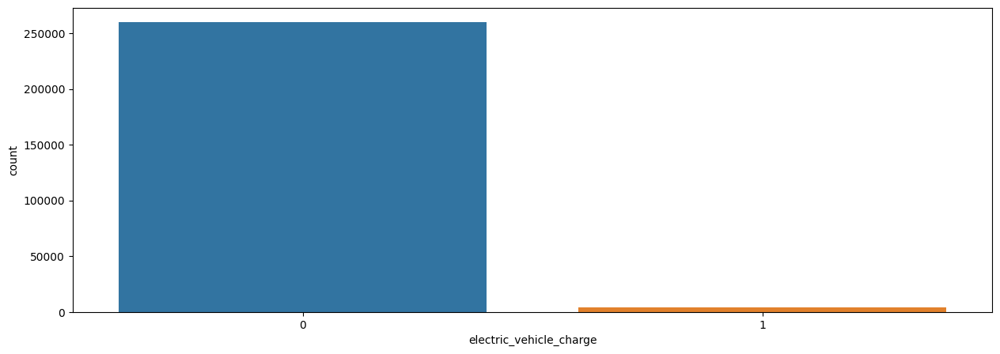

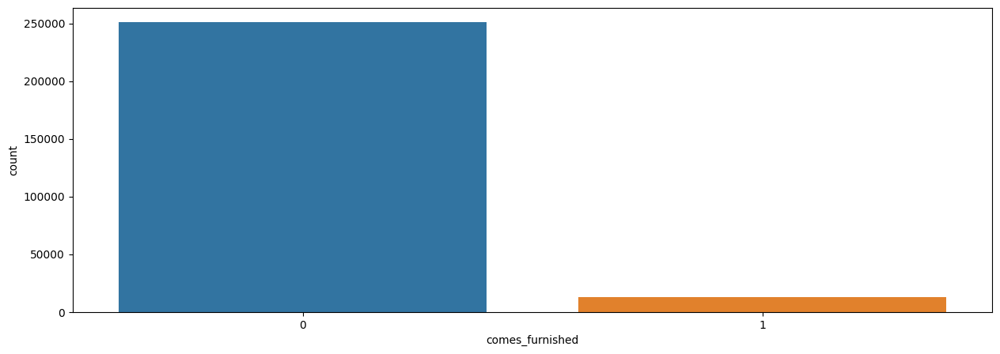

In [109]:
for i in list:
    #in this case,we have to first mention figure and then draw distribution
    plt.figure(figsize=(15,5))
    label_distribution(i)

## Outliers

1) Visualization (dist, Boxplot)
2) Statistical Approaches (Q-Plot)

In [110]:
imp_features=['price','beds','baths','sqfeet']

<AxesSubplot: xlabel='price'>

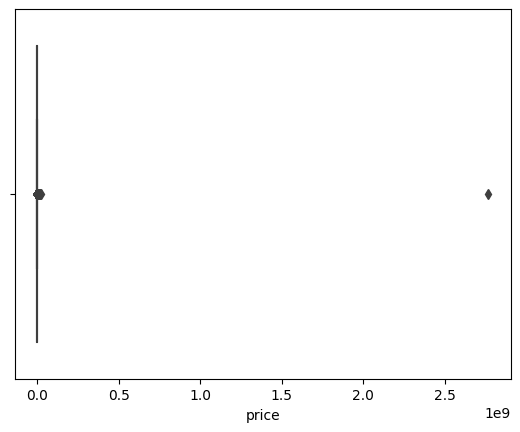

In [111]:
sns.boxplot(data=df,x='price')

<AxesSubplot: xlabel='baths'>

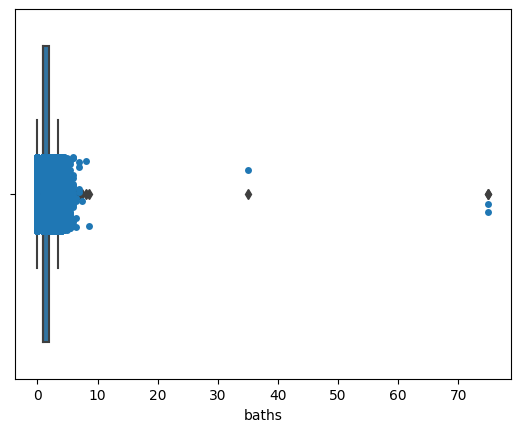

In [112]:
sns.stripplot(data=df, x='baths')
sns.boxplot(data=df, x='baths')

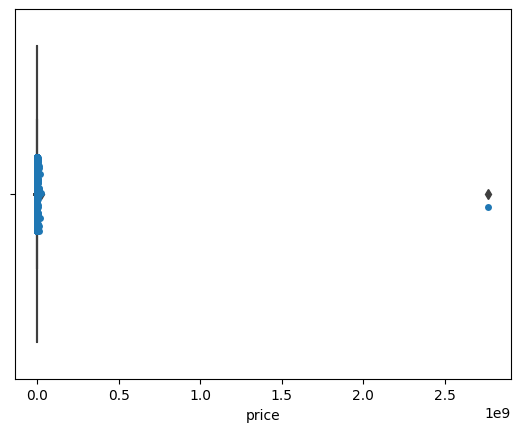

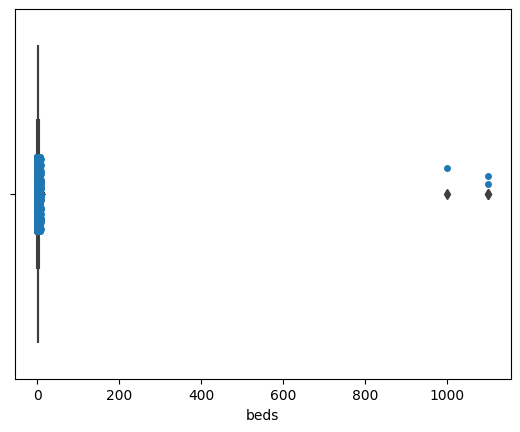

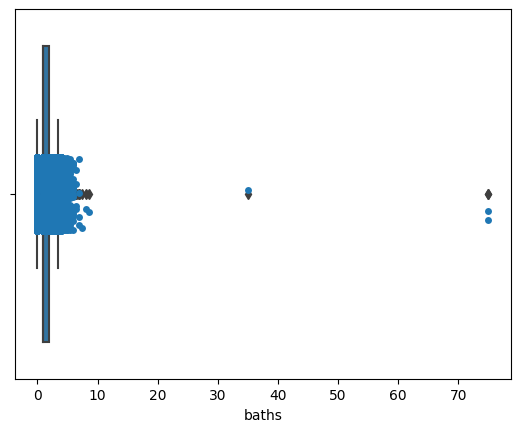

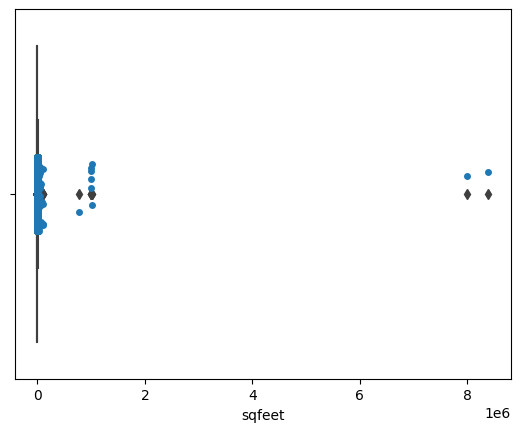

In [113]:
for feature in imp_features:
    plt.figure()
    sns.stripplot(data=df,x=feature)
    sns.boxplot(data=df,x=feature)

#### Statistical Approach

In [114]:
import statsmodels.api as sm

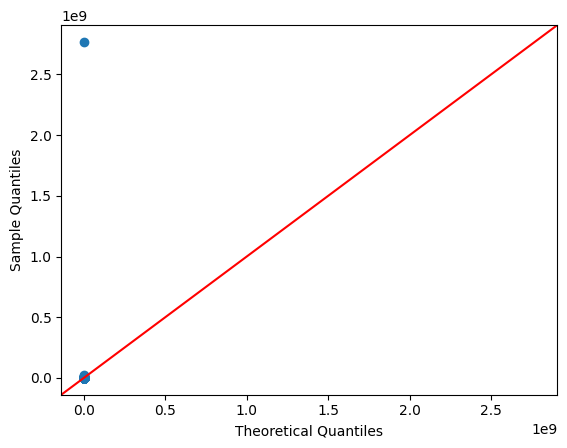

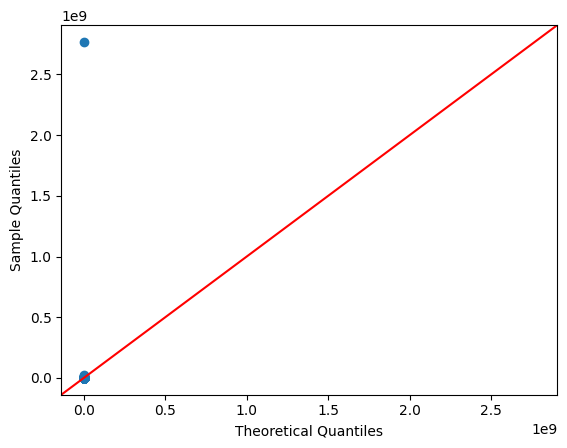

In [115]:
sm.qqplot(df['price'],line='45')

In [116]:
## Automating stuffs
def qq_plots(df,col):
    plt.figure(figsize=(10, 4))
    sm.qqplot(df[col],line='45')
    plt.title("Normal QQPlot of {} ".format(col))

<Figure size 1000x400 with 0 Axes>

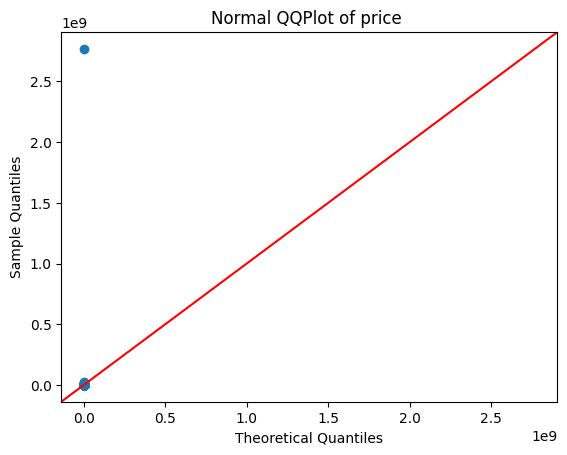

<Figure size 1000x400 with 0 Axes>

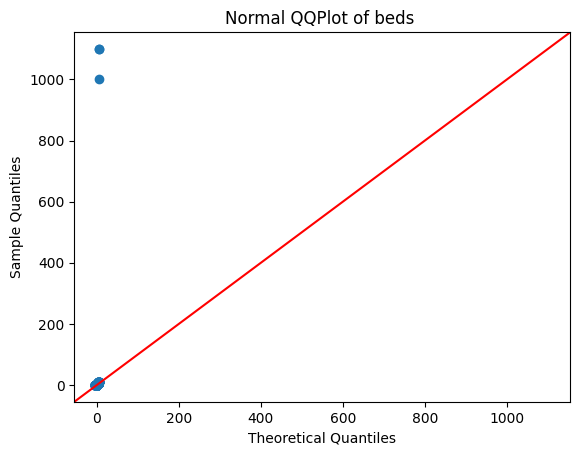

<Figure size 1000x400 with 0 Axes>

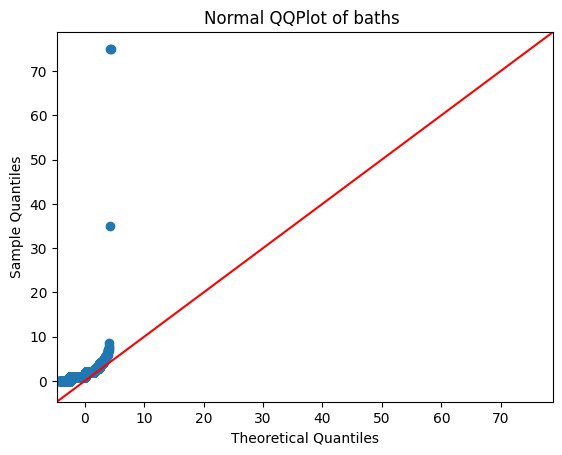

<Figure size 1000x400 with 0 Axes>

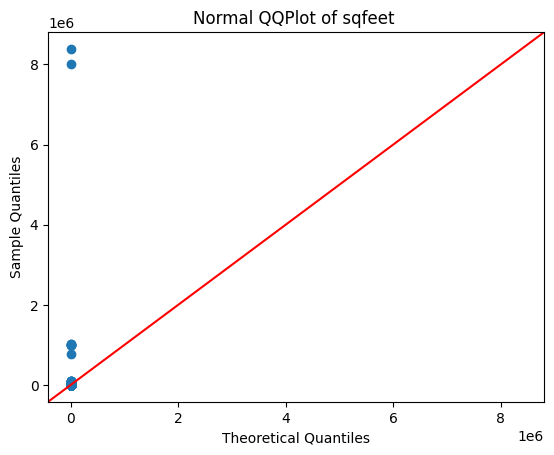

In [117]:
for feature in imp_features:    
    qq_plots(df,feature)

After detecting the outlier we should remove\treat the outlier 
Outliers badly affect mean and standard deviation of the dataset. 
It increases the error variance and reduces the power of statistical tests.
Most machine learning algorithms do not work well in the presence of outlier. So it is desirable to detect and remove outliers.
With all these reasons we must be careful about outlier and treat them before build a ML model. 
There are some techniques used to deal with outliers.
 1. Deleting observations but thts not a professional approach,as in this case there is a information loss in our data.
    We delete outlier values if it is due to data entry error..

 2. Transforming values.
    Transforming variables can also eliminate outliers. These transformed values reduces the variation caused by extreme values.
    1. Scaling
    2. Log transformation
    3. Cube Root Normalization
    4. Box-Cox transformation

    * These techniques convert higher values of data to smaller values.
    * If the data has to many extreme values or skewed, this method helps to make your data normal.
    * But These technique not always give you the best results.
    * There is no lose of data from these methods.
    * In all these method boxcox transformation gives the best result.   


 3. Imputation by using some statistical techniques to deal with outliers like Median , Z-Score , IQR , Robust Z-score

### Imputing Outliers using Statistical techmiques

In [118]:
data=df.copy()

In [119]:
data['price'].nlargest(400)

110953    2768307249
23893       21701907
247250      18502000
247251      18502000
73730       12000000
             ...    
176631          6500
248957          6500
249264          6500
249377          6500
26659           6499
Name: price, Length: 400, dtype: int64

In [120]:
data['price'].median()

1060.0

In [121]:
data['price'].mean()

12330.078647766433

In [122]:
### where-ever price is >5000 replace it with median bcz median doesnt gets affected with outliers
data['price']=np.where(data['price']>5000,data['price'].median(),data['price'])

In [123]:
data['price'].mean()

1207.3528515265136

In [124]:
data['price'].median()

1060.0

In [125]:
### Automate stuffs using function 
def deal_with_outliers(feature,threshold):
    data[feature]=np.where(data[feature]>threshold,data[feature].median(),data[feature])

/var/folders/qz/f43xldgd339f63pl19dqgt9w0000gn/T/ipykernel_41647/2458277208.py:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df['price'])


<AxesSubplot: xlabel='price', ylabel='Density'>

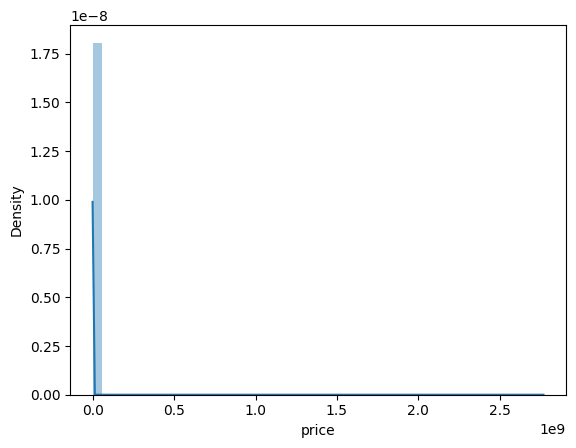

In [126]:
##distrbution of price before Dealing with outliers
sns.distplot(df['price'])

/var/folders/qz/f43xldgd339f63pl19dqgt9w0000gn/T/ipykernel_41647/1551593533.py:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(data['price'])


<AxesSubplot: xlabel='price', ylabel='Density'>

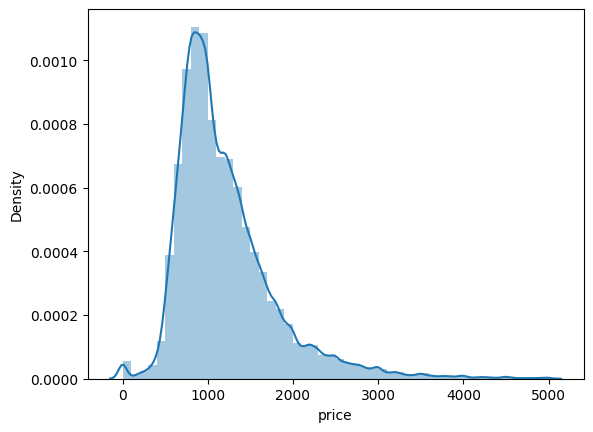

In [127]:
## as it is almost Normally Distributed data, this data is suitable for your ML algo
sns.distplot(data['price'])

### sqfeet Outliers

In [128]:
data['sqfeet'].nlargest(200)

195751    8388607
7862      8000000
42751     1019856
42752     1019856
63022      999999
           ...   
22519        5000
30498        5000
31092        5000
31294        5000
35225        5000
Name: sqfeet, Length: 200, dtype: int64

In [129]:
deal_with_outliers('sqfeet',5000)

/var/folders/qz/f43xldgd339f63pl19dqgt9w0000gn/T/ipykernel_41647/3054299337.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df['sqfeet'])


<AxesSubplot: xlabel='sqfeet', ylabel='Density'>

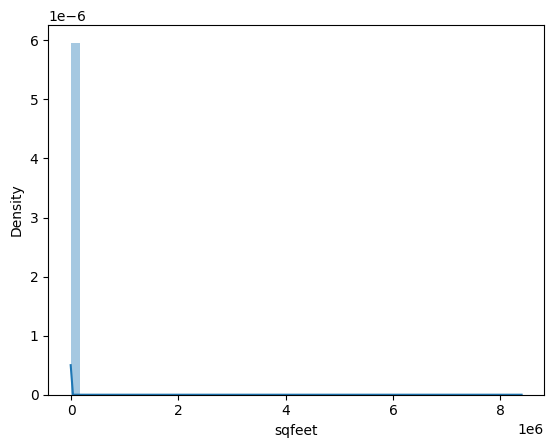

In [130]:
sns.distplot(df['sqfeet'])

/var/folders/qz/f43xldgd339f63pl19dqgt9w0000gn/T/ipykernel_41647/3517362144.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(data['sqfeet'])


<AxesSubplot: xlabel='sqfeet', ylabel='Density'>

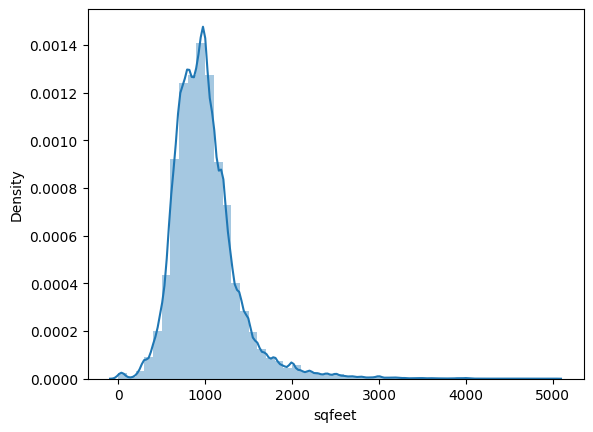

In [131]:
sns.distplot(data['sqfeet'])

### beds Outliers

In [132]:
data['beds'].nlargest(100)

125920    1100
126923    1100
73839     1000
52993        8
76257        8
          ... 
53433        6
54694        6
54697        6
54881        6
56542        6
Name: beds, Length: 100, dtype: int64

In [133]:
deal_with_outliers('beds',999)

/var/folders/qz/f43xldgd339f63pl19dqgt9w0000gn/T/ipykernel_41647/1631288009.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df['beds'])


<AxesSubplot: xlabel='beds', ylabel='Density'>

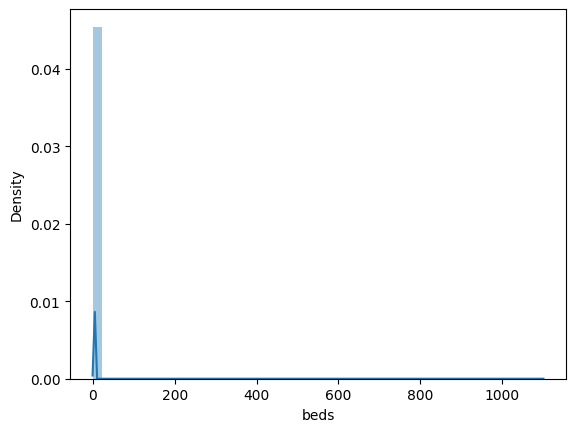

In [134]:
sns.distplot(df['beds'])

/var/folders/qz/f43xldgd339f63pl19dqgt9w0000gn/T/ipykernel_41647/3092126547.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(data['beds'])


<AxesSubplot: xlabel='beds', ylabel='Density'>

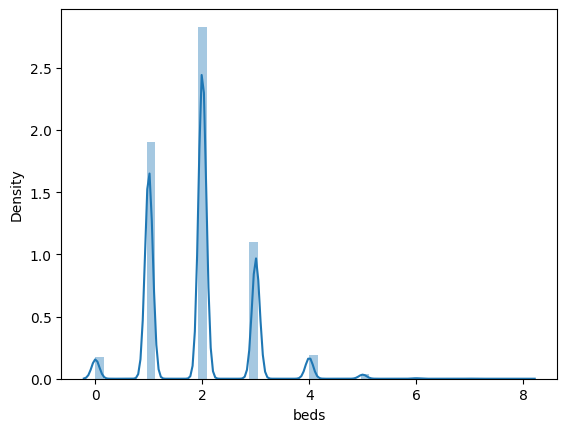

In [135]:
sns.distplot(data['beds'])

### baths Outliers

In [136]:
data['baths'].nlargest(50)

125920    75.0
126923    75.0
73839     35.0
73730      8.5
198055     8.0
147730     7.5
51821      7.0
105365     7.0
147539     7.0
263801     7.0
26354      6.5
35177      6.5
62928      6.5
117774     6.5
29290      6.0
34231      6.0
34698      6.0
39679      6.0
48285      6.0
62703      6.0
74580      6.0
118178     6.0
121787     6.0
138789     6.0
213772     6.0
223274     6.0
223525     6.0
223527     6.0
225173     6.0
225174     6.0
225176     6.0
43347      5.5
51891      5.5
88835      5.5
126218     5.5
137778     5.5
137781     5.5
137787     5.5
137789     5.5
137795     5.5
137812     5.5
137824     5.5
137850     5.5
137885     5.5
137900     5.5
137902     5.5
137956     5.5
138002     5.5
138030     5.5
190626     5.5
Name: baths, dtype: float64

In [137]:
deal_with_outliers('baths',10)

/var/folders/qz/f43xldgd339f63pl19dqgt9w0000gn/T/ipykernel_41647/752651704.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df['baths'])


<AxesSubplot: xlabel='baths', ylabel='Density'>

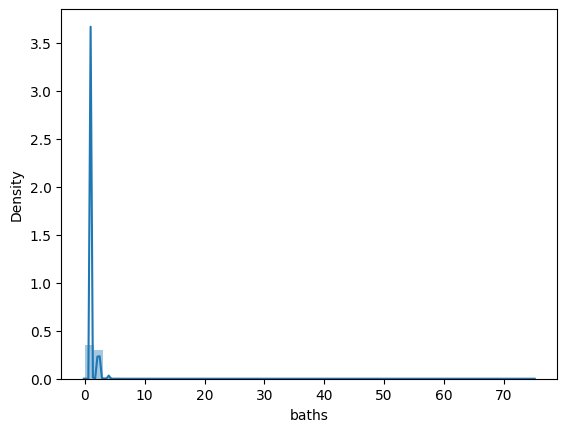

In [138]:
sns.distplot(df['baths'])

/var/folders/qz/f43xldgd339f63pl19dqgt9w0000gn/T/ipykernel_41647/1188153371.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(data['baths'])


<AxesSubplot: xlabel='baths', ylabel='Density'>

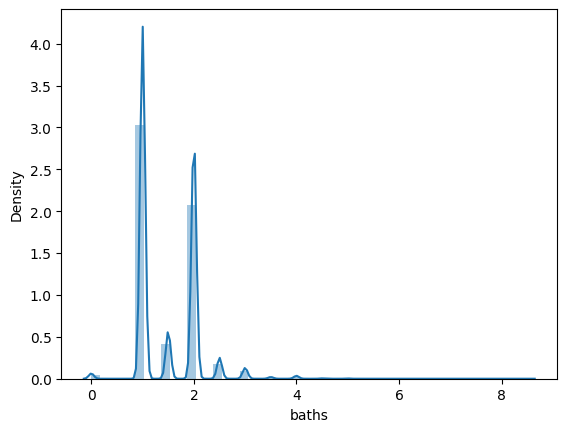

In [139]:
sns.distplot(data['baths'])

<AxesSubplot: xlabel='baths'>

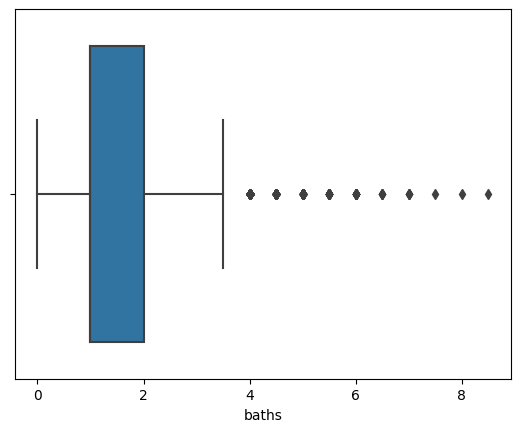

In [140]:
sns.boxplot(data=data,x='baths')

## In-Depth Analysis

### Analyse Distribution of price where pets are allowed & pets are not allowed

In [141]:
data[data['dogs_allowed']==0]['price']

10         890.0
49        1250.0
64         850.0
65        1050.0
66         814.0
           ...  
265164    1500.0
265169     550.0
265173    1700.0
265174     654.0
265175    1200.0
Name: price, Length: 79995, dtype: float64

/var/folders/qz/f43xldgd339f63pl19dqgt9w0000gn/T/ipykernel_41647/473024001.py:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(data[data['dogs_allowed']==0]['price'],hist=False,label="Price where pets are not allowed")
/var/folders/qz/f43xldgd339f63pl19dqgt9w0000gn/T/ipykernel_41647/473024001.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.

Text(0.5, 1.0, 'Income Distribution')

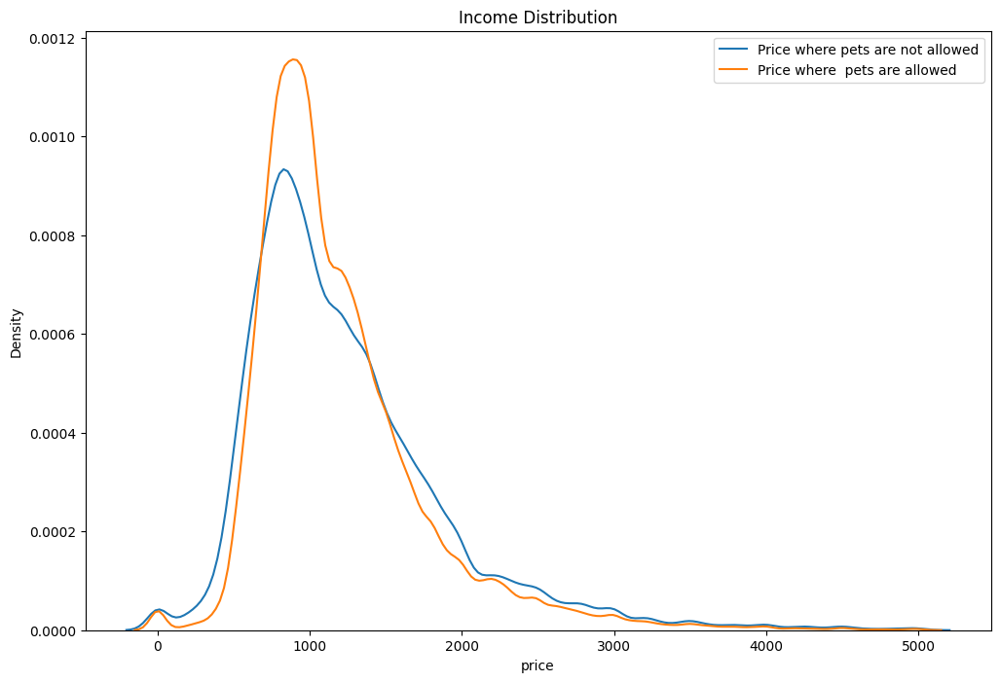

In [142]:
plt.figure(figsize=(12,8))
sns.distplot(data[data['dogs_allowed']==0]['price'],hist=False,label="Price where pets are not allowed")
sns.distplot(data[data['dogs_allowed']==1]['price'],hist=False,label="Price where  pets are allowed")
plt.legend()
plt.title("Income Distribution")

In [143]:
# Automate above staff
def price_distribution(feature,label):
    plt.figure(figsize=(12,8))
    sns.distplot(data[data[feature]==0]['price'],hist=False,label="Price where {} are not allowed".format(label))
    sns.distplot(data[data[feature]==1]['price'],hist=False,label="Price where {} are allowed".format(label))
    plt.legend()
    plt.title("Income Distribution")

/var/folders/qz/f43xldgd339f63pl19dqgt9w0000gn/T/ipykernel_41647/3005188726.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(data[data[feature]==0]['price'],hist=False,label="Price where {} are not allowed".format(label))
/var/folders/qz/f43xldgd339f63pl19dqgt9w0000gn/T/ipykernel_41647/3005188726.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https:

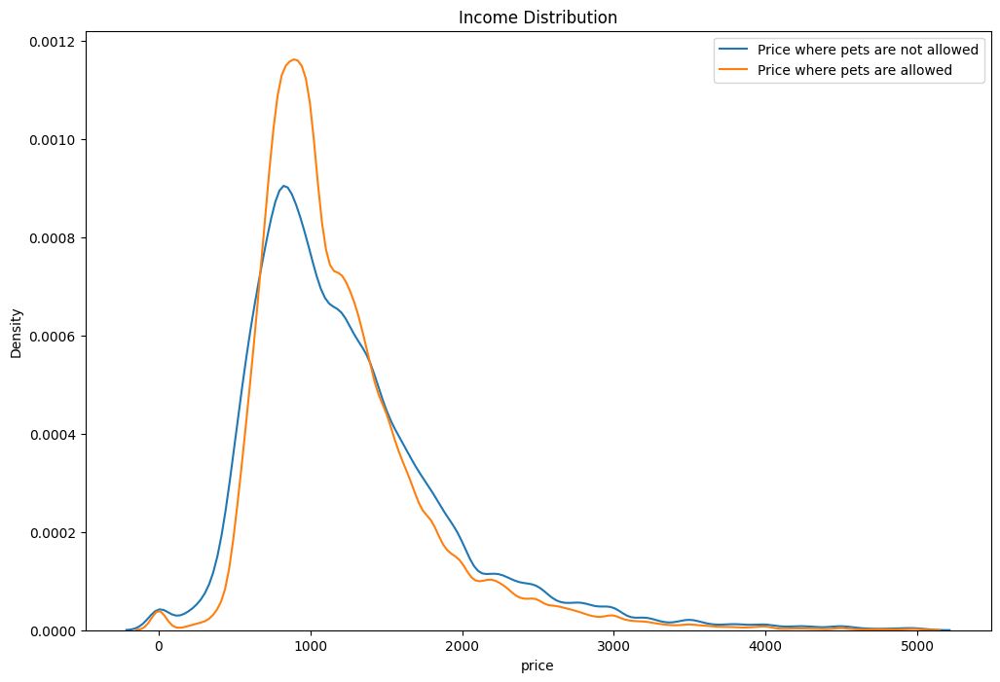

In [144]:
price_distribution('cats_allowed','pets')

From the above plot we could say that price of house is not varying in case of having pets or not !

In [145]:
df.columns

Index(['id', 'url', 'region', 'region_url', 'price', 'type', 'sqfeet', 'beds',
       'baths', 'cats_allowed', 'dogs_allowed', 'smoking_allowed',
       'wheelchair_access', 'electric_vehicle_charge', 'comes_furnished',
       'laundry_options', 'parking_options', 'image_url', 'description', 'lat',
       'long', 'state'],
      dtype='object')

In [146]:
df['electric_vehicle_charge'].unique()

array([0, 1])

/var/folders/qz/f43xldgd339f63pl19dqgt9w0000gn/T/ipykernel_41647/3005188726.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(data[data[feature]==0]['price'],hist=False,label="Price where {} are not allowed".format(label))
/var/folders/qz/f43xldgd339f63pl19dqgt9w0000gn/T/ipykernel_41647/3005188726.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https:

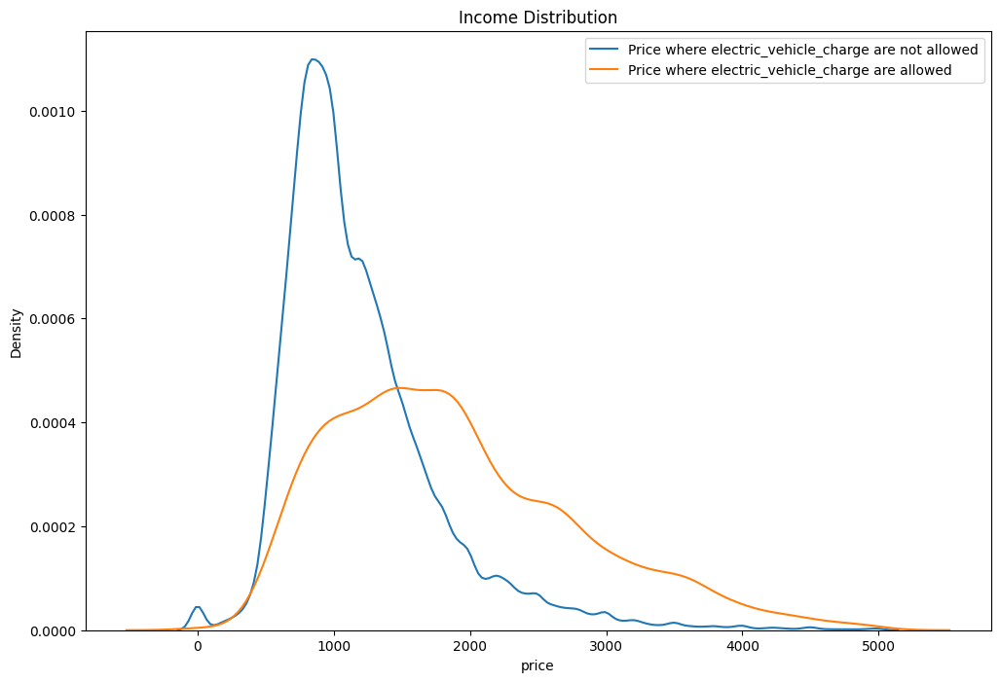

In [147]:
price_distribution('electric_vehicle_charge','electric_vehicle_charge')

From the above plot we could say that price of house is higher if it has a facility of charging electric_vehicle

/var/folders/qz/f43xldgd339f63pl19dqgt9w0000gn/T/ipykernel_41647/3005188726.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(data[data[feature]==0]['price'],hist=False,label="Price where {} are not allowed".format(label))
/var/folders/qz/f43xldgd339f63pl19dqgt9w0000gn/T/ipykernel_41647/3005188726.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https:

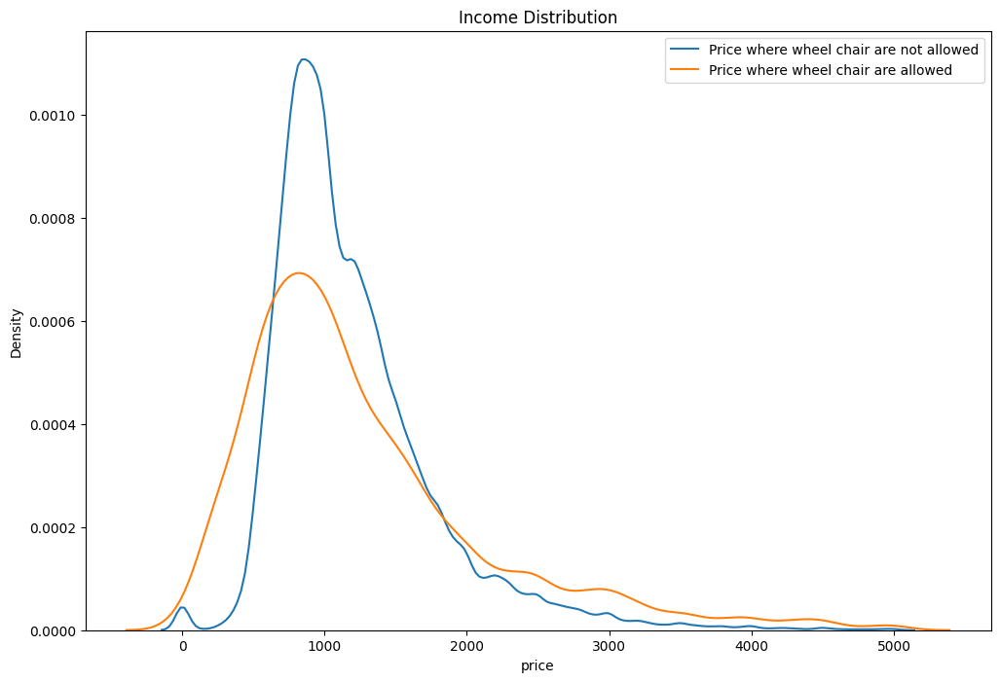

In [148]:
price_distribution('comes_furnished','wheel chair')

From the above plot we could say that price of house is not varying in case of furnished & not furnished houses!

### Relationship between area & Price

In [149]:
import plotly.express as px
fig=px.scatter(data, x="price", y="sqfeet")
fig.show()

In [150]:
#### There is a complex relationship between Price & sqfeet it means your Linear Regression algo doesnt perform better
### u have to use some ensemble algos to predict price that will definitely perform better !

## Features Co-relation

In [151]:
data.columns

Index(['id', 'url', 'region', 'region_url', 'price', 'type', 'sqfeet', 'beds',
       'baths', 'cats_allowed', 'dogs_allowed', 'smoking_allowed',
       'wheelchair_access', 'electric_vehicle_charge', 'comes_furnished',
       'laundry_options', 'parking_options', 'image_url', 'description', 'lat',
       'long', 'state'],
      dtype='object')

In [152]:
data.corr()

/var/folders/qz/f43xldgd339f63pl19dqgt9w0000gn/T/ipykernel_41647/2627137660.py:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



,id,price,sqfeet,beds,baths,cats_allowed,dogs_allowed,smoking_allowed,wheelchair_access,electric_vehicle_charge,comes_furnished,lat,long
id,1.000000,0.134772,-0.038769,-0.064331,-0.029581,0.034818,0.024426,0.011674,0.012306,0.019057,-0.022436,-0.006378,-0.102851
price,0.134772,1.000000,0.326490,0.178142,0.252186,-0.042037,-0.033900,-0.165164,0.085760,0.137642,0.023183,-0.034644,-0.218584
sqfeet,-0.038769,0.326490,1.000000,0.743962,0.642934,-0.078665,-0.036908,-0.051534,-0.000421,0.007912,0.017238,-0.000621,0.037274
beds,-0.064331,0.178142,0.743962,1.000000,0.641341,-0.071272,-0.035495,-0.014372,-0.027641,-0.018272,0.017712,0.017202,0.020761
baths,-0.029581,0.252186,0.642934,0.641341,1.000000,-0.021490,0.018232,-0.020555,0.030413,0.009954,0.043990,-0.104677,-0.008859
cats_allowed,0.034818,-0.042037,-0.078665,-0.071272,-0.021490,1.000000,0.887186,0.036541,0.118325,0.053525,-0.076369,-0.013148,0.054597
dogs_allowed,0.024426,-0.033900,-0.036908,-0.035495,0.018232,0.887186,1.000000,0.031869,0.128308,0.053380,-0.055738,-0.052023,0.039935
smoking_allowed,0.011674,-0.165164,-0.051534,-0.014372,-0.020555,0.036541,0.031869,1.000000,-0.204326,-0.100159,-0.150293,-0.129610,0.118966
wheelchair_access,0.012306,0.085760,-0.000421,-0.027641,0.030413,0.118325,0.128308,-0.204326,1.000000,0.206526,0.152672,-0.019009,-0.006892
electric_vehicle_charge,0.019057,0.137642,0.007912,-0.018272,0.009954,0.053525,0.053380,-0.100159,0.206526,1.000000,0.069265,0.010245,-0.061936


In [153]:
data.corr().style.background_gradient(cmap='Reds')

/var/folders/qz/f43xldgd339f63pl19dqgt9w0000gn/T/ipykernel_41647/2611315215.py:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



,id,price,sqfeet,beds,baths,cats_allowed,dogs_allowed,smoking_allowed,wheelchair_access,electric_vehicle_charge,comes_furnished,lat,long
id,1.000000,0.134772,-0.038769,-0.064331,-0.029581,0.034818,0.024426,0.011674,0.012306,0.019057,-0.022436,-0.006378,-0.102851
price,0.134772,1.000000,0.326490,0.178142,0.252186,-0.042037,-0.033900,-0.165164,0.085760,0.137642,0.023183,-0.034644,-0.218584
sqfeet,-0.038769,0.326490,1.000000,0.743962,0.642934,-0.078665,-0.036908,-0.051534,-0.000421,0.007912,0.017238,-0.000621,0.037274
beds,-0.064331,0.178142,0.743962,1.000000,0.641341,-0.071272,-0.035495,-0.014372,-0.027641,-0.018272,0.017712,0.017202,0.020761
baths,-0.029581,0.252186,0.642934,0.641341,1.000000,-0.021490,0.018232,-0.020555,0.030413,0.009954,0.043990,-0.104677,-0.008859
cats_allowed,0.034818,-0.042037,-0.078665,-0.071272,-0.021490,1.000000,0.887186,0.036541,0.118325,0.053525,-0.076369,-0.013148,0.054597
dogs_allowed,0.024426,-0.033900,-0.036908,-0.035495,0.018232,0.887186,1.000000,0.031869,0.128308,0.053380,-0.055738,-0.052023,0.039935
smoking_allowed,0.011674,-0.165164,-0.051534,-0.014372,-0.020555,0.036541,0.031869,1.000000,-0.204326,-0.100159,-0.150293,-0.129610,0.118966
wheelchair_access,0.012306,0.085760,-0.000421,-0.027641,0.030413,0.118325,0.128308,-0.204326,1.000000,0.206526,0.152672,-0.019009,-0.006892
electric_vehicle_charge,0.019057,0.137642,0.007912,-0.018272,0.009954,0.053525,0.053380,-0.100159,0.206526,1.000000,0.069265,0.010245,-0.061936


Higher Co-relation group

- sqfeet-- beds
- sqfeet-- baths
- dogs_allowed-- cats_allowed 

it means we can drop beds, baths, cats_allowed

In [154]:
dataframe=data.copy()

In [155]:
dataframe.columns

Index(['id', 'url', 'region', 'region_url', 'price', 'type', 'sqfeet', 'beds',
       'baths', 'cats_allowed', 'dogs_allowed', 'smoking_allowed',
       'wheelchair_access', 'electric_vehicle_charge', 'comes_furnished',
       'laundry_options', 'parking_options', 'image_url', 'description', 'lat',
       'long', 'state'],
      dtype='object')

In [156]:
dataframe.drop(['id','url','region_url','beds','baths','cats_allowed','image_url','description','lat','long'],axis=1,inplace=True)

In [157]:
dataframe.shape

(263771, 12)

In [158]:
dataframe.columns

Index(['region', 'price', 'type', 'sqfeet', 'dogs_allowed', 'smoking_allowed',
       'wheelchair_access', 'electric_vehicle_charge', 'comes_furnished',
       'laundry_options', 'parking_options', 'state'],
      dtype='object')

## Feature Encoding ( categorical features )

In [159]:
dataframe.dtypes

region                      object
price                      float64
type                        object
sqfeet                     float64
dogs_allowed                 int64
smoking_allowed              int64
wheelchair_access            int64
electric_vehicle_charge      int64
comes_furnished              int64
laundry_options             object
parking_options             object
state                       object
dtype: object

In [160]:
categorical_features=[feature for feature in dataframe.columns if dataframe[feature].dtype=='object']
categorical_features

['region', 'type', 'laundry_options', 'parking_options', 'state']

#### check all the sub-categories in categorical features to check wht encoding technique we can apply

- Less subcategories -> <b>One-hot/Label Encoding</b>
- More subcategories -> One-hot/Label Encoding will have Curse of dimensionality! -> - <b>Frequency Encoding</b>,<b>Mean Encoding</b> or <b>Prob Ratio Encoding</b>


In [161]:
for feature in categorical_features:
    print('Total diff features in {} are {}'.format(feature,len(dataframe[feature].unique())))

Total diff features in region are 298
Total diff features in type are 12
Total diff features in laundry_options are 5
Total diff features in parking_options are 7
Total diff features in state are 38


In [162]:
pd.set_option('display.max_rows',298)
region_count=dataframe['region'].value_counts()
region_count

jacksonville                  4242
rochester                     3673
fayetteville                  3636
omaha / council bluffs        2719
boulder                       2606
denver                        2582
ventura county                2578
savannah / hinesville         2575
stockton                      2569
fort collins / north CO       2566
inland empire                 2559
orlando                       2555
lincoln                       2547
reno / tahoe                  2535
augusta                       2522
jackson                       2519
colorado springs              2518
space coast                   2508
washington, DC                2478
tucson                        2463
minneapolis / st paul         2444
charlotte                     2435
daytona beach                 2387
orange county                 2386
st louis, MO                  2385
sacramento                    2382
raleigh / durham / CH         2365
lakeland                      2355
san diego           

In [163]:
len(region_count[region_count>500])

141

In [164]:
important=region_count[region_count>500].index
important

Index(['jacksonville', 'rochester', 'fayetteville', 'omaha / council bluffs',
       'boulder', 'denver', 'ventura county', 'savannah / hinesville',
       'stockton', 'fort collins / north CO',
       ...
       'fargo / moorhead', 'columbia / jeff city', 'long island', 'ocala',
       'birmingham', 'southern maryland', 'billings', 'lawrence', 'monroe',
       'valdosta'],
      dtype='object', length=141)

In [165]:
def remove(x):
    if x not in important:
        return 'other'
    else:
        return x

In [166]:
dataframe['region']=dataframe['region'].apply(remove)

In [167]:
# 2nd way using lambda function
# dataframe['region'].apply(lambda x: 'other' if x not in important else x)

In [168]:
dataframe['region'].tail(20)

265169    columbus
265170       other
265171    columbus
265172    columbus
265173    columbus
265174    columbus
265175    columbus
265176    columbus
265177    columbus
265178    columbus
265179    columbus
265180    columbus
265181    columbus
265182    columbus
265183    columbus
265184    columbus
265185    columbus
265186    columbus
265187    columbus
265188    columbus
Name: region, dtype: object

In [169]:
dataframe['region'].nunique()

142

In [170]:
# Automate the above
def get_stats(feature):
    count=dataframe[feature].value_counts()
    pd.set_option('display.max_rows',df[feature].nunique())
    return count

In [171]:
get_stats('state')

ca    32997
fl    31687
nc    18490
mi    14439
ga    13773
co    11200
ny     9958
il     9615
ks     7889
ia     7462
mn     7445
md     7437
la     7291
az     6742
oh     6537
in     6400
al     6190
nj     5601
ky     5397
ms     4963
ma     4894
id     4365
ct     3753
nd     3428
ar     3145
nm     2907
nv     2836
ne     2693
dc     2478
ak     2148
mo     2137
de     2046
hi     1830
nh     1754
mt     1331
me      420
ok       49
or       44
Name: state, dtype: int64

In [172]:
def extract_imp_sub_categories(feature,threshold):
    count=dataframe[feature].value_counts()
    important=count[count>threshold].index
    return important

In [173]:
sub_cat=extract_imp_sub_categories('state',2000)
sub_cat

Index(['ca', 'fl', 'nc', 'mi', 'ga', 'co', 'ny', 'il', 'ks', 'ia', 'mn', 'md',
       'la', 'az', 'oh', 'in', 'al', 'nj', 'ky', 'ms', 'ma', 'id', 'ct', 'nd',
       'ar', 'nm', 'nv', 'ne', 'dc', 'ak', 'mo', 'de'],
      dtype='object')

In [174]:
dataframe['state']=dataframe['state'].apply(lambda x:'other' if x not in sub_cat else x)

In [175]:
dataframe['state'].tail(20)

265169       oh
265170    other
265171       oh
265172       oh
265173       oh
265174       oh
265175       oh
265176       oh
265177       oh
265178       oh
265179       oh
265180       oh
265181       oh
265182       oh
265183       oh
265184       oh
265185       oh
265186       oh
265187       oh
265188       oh
Name: state, dtype: object

In [176]:
dataframe['state'].nunique()

33

In [177]:
get_stats('type')

apartment          217090
house               23400
townhouse           10295
condo                4841
duplex               3436
manufactured         3004
cottage/cabin         697
loft                  510
flat                  349
in-law                144
land                    4
assisted living         1
Name: type, dtype: int64

In [178]:
imp2=extract_imp_sub_categories('type',3000)
imp2

Index(['apartment', 'house', 'townhouse', 'condo', 'duplex', 'manufactured'], dtype='object')

In [179]:
dataframe['type']=dataframe['type'].apply(lambda x:'other' if x not in imp2 else x)

In [180]:
dataframe['type'].nunique()

7

In [181]:
for feature in categorical_features:
    print('total diff features in {} are {}'.format(feature,len(dataframe[feature].unique())))

total diff features in region are 142
total diff features in type are 7
total diff features in laundry_options are 5
total diff features in parking_options are 7
total diff features in state are 33


## Frequency Encoding (region,state)

2 different ways:

1) In-built (Count Encoder)
2) dictionary (key-value = New York-10K)

In [182]:
dictionary=dict(dataframe['region'].value_counts())
dictionary

{'other': 23345,
 'jacksonville': 4242,
 'rochester': 3673,
 'fayetteville': 3636,
 'omaha / council bluffs': 2719,
 'boulder': 2606,
 'denver': 2582,
 'ventura county': 2578,
 'savannah / hinesville': 2575,
 'stockton': 2569,
 'fort collins / north CO': 2566,
 'inland empire': 2559,
 'orlando': 2555,
 'lincoln': 2547,
 'reno / tahoe': 2535,
 'augusta': 2522,
 'jackson': 2519,
 'colorado springs': 2518,
 'space coast': 2508,
 'washington, DC': 2478,
 'tucson': 2463,
 'minneapolis / st paul': 2444,
 'charlotte': 2435,
 'daytona beach': 2387,
 'orange county': 2386,
 'st louis, MO': 2385,
 'sacramento': 2382,
 'raleigh / durham / CH': 2365,
 'lakeland': 2355,
 'san diego': 2351,
 'grand rapids': 2339,
 'SF bay area': 2319,
 'sarasota-bradenton': 2302,
 'ann arbor': 2281,
 'atlanta': 2273,
 'des moines': 2265,
 'lexington': 2262,
 'topeka': 2244,
 'los angeles': 2244,
 "spokane / coeur d'alene": 2207,
 'las vegas': 2203,
 'south jersey': 2201,
 'cleveland': 2186,
 'lansing': 2184,
 'fresn

In [183]:
dataframe['region']=dataframe['region'].map(dictionary)

In [184]:
dataframe['region']

0          558
1          558
2          558
3          558
4          558
          ... 
265184    2050
265185    2050
265186    2050
265187    2050
265188    2050
Name: region, Length: 263771, dtype: int64

In [185]:
#2nd way

In [186]:
#!pip install category_encoders

In [187]:
from category_encoders import CountEncoder

In [188]:
dataframe['state'].head()

0    al
1    al
2    al
3    al
4    al
Name: state, dtype: object

In [190]:
pd.set_option('display.max_rows',33)
dataframe['state'].value_counts()

ca       32997
fl       31687
nc       18490
mi       14439
ga       13773
co       11200
ny        9958
il        9615
ks        7889
ia        7462
mn        7445
md        7437
la        7291
az        6742
oh        6537
in        6400
al        6190
nj        5601
other     5428
ky        5397
ms        4963
ma        4894
id        4365
ct        3753
nd        3428
ar        3145
nm        2907
nv        2836
ne        2693
dc        2478
ak        2148
mo        2137
de        2046
Name: state, dtype: int64

In [191]:
ce=CountEncoder()

In [192]:
dataframe['state']=ce.fit_transform(dataframe['state'])

In [193]:
dataframe['state'].head()

0    6190
1    6190
2    6190
3    6190
4    6190
Name: state, dtype: int64

## Label Encoding (type, laundry_options, parking_options)

In [194]:
from sklearn.preprocessing import LabelEncoder

In [195]:
le=LabelEncoder()

In [199]:
for feature in ['laundry_options','parking_options','type']:    
    dataframe[feature]=le.fit_transform(dataframe[feature])

In [200]:
dataframe.head()

,region,price,type,sqfeet,dogs_allowed,smoking_allowed,wheelchair_access,electric_vehicle_charge,comes_furnished,laundry_options,parking_options,state
0,558,1195.0,0,1908.0,1,1,0,0,0,1,5,16
1,558,1120.0,0,1319.0,1,1,0,0,0,1,4,16
2,558,825.0,0,1133.0,1,1,0,0,0,1,5,16
3,558,800.0,0,927.0,1,1,0,0,0,1,5,16
4,558,785.0,0,1047.0,1,1,0,0,0,1,5,16


In [201]:
dataframe.dtypes

region                       int64
price                      float64
type                         int64
sqfeet                     float64
dogs_allowed                 int64
smoking_allowed              int64
wheelchair_access            int64
electric_vehicle_charge      int64
comes_furnished              int64
laundry_options              int64
parking_options              int64
state                        int64
dtype: object

## Build Decision Tree Model

In [202]:
x=dataframe.drop('price',axis=1)

In [203]:
y=dataframe['price']

In [210]:
from sklearn.model_selection import train_test_split

In [211]:
X_train,X_test,y_train,y_test=train_test_split(x,y,train_size=0.8,random_state=0)

In [212]:
from sklearn.tree import DecisionTreeRegressor

In [213]:
dt=DecisionTreeRegressor(random_state=0)

In [214]:
dt.fit(X_train,y_train)

DecisionTreeRegressor(random_state=0)

In [215]:
y_pred=dt.predict(X_test)

In [216]:
y_pred

array([1400. , 2150. , 2867.5, ...,  518. , 2064. , 1099. ])

In [217]:
from sklearn.metrics import r2_score

In [218]:
r2=r2_score(y_test,y_pred)
r2

0.6658802843042708

## Multiple models

In [219]:
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor

In [220]:
models = []
models.append(('LinearRegression', LinearRegression()))
models.append(('RandomForest', RandomForestRegressor()))
models.append(('Decision Tree', DecisionTreeRegressor()))
models.append(('KNN', KNeighborsRegressor(n_neighbors = 5)))

In [222]:
models

[('LinearRegression', LinearRegression()),
 ('RandomForest', RandomForestRegressor()),
 ('Decision Tree', DecisionTreeRegressor()),
 ('KNN', KNeighborsRegressor())]

In [221]:
for name, model in models:
    print(name)
    model.fit(x_train, y_train)
    
    # Make predictions
    predictions = model.predict(x_test)

    # Compute the error
    print(r2_score(predictions, y_test))

    print('\n')

LinearRegression
-2.7537398623102867


RandomForest
0.7590372850945686


Decision Tree
0.6732811840308235


KNN
0.6304699408514172




## Hyperparameter Tuning

In [224]:
## Hyperparameter optimization using RandomizedSearchCV
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV

In [225]:
#Randomized Search CV

# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 100, stop = 1200, num = 4)]
# Number of features to consider at every split
max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(5, 30, num = 3)]
# Minimum number of samples required to split a node
min_samples_split = [ 5, 15, 100]
# Minimum number of samples required at each leaf node
#min_samples_leaf = [1, 5, 10]

In [226]:
random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split}

In [227]:
random_grid

{'n_estimators': [100, 466, 833, 1200],
 'max_features': ['auto', 'sqrt'],
 'max_depth': [5, 17, 30],
 'min_samples_split': [5, 15, 100]}

In [228]:
reg_rf=RandomForestRegressor()

In [229]:
# Random search of parameters, using 5 fold cross validation, 
# search across 100 different combinations
rf_random = RandomizedSearchCV(estimator = reg_rf, param_distributions = random_grid, cv = 3, verbose=2, n_jobs = -1)

In [230]:
rf_random.fit(X_train,Y_train)

Fitting 3 folds for each of 10 candidates, totalling 30 fits


/opt/homebrew/lib/python3.10/site-packages/sklearn/ensemble/_forest.py:416: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
/opt/homebrew/lib/python3.10/site-packages/sklearn/ensemble/_forest.py:416: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
/opt/homebrew/lib/python3.10/site-packages/sklearn/ensemble/_forest.py:416: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestR

[CV] END max_depth=17, max_features=sqrt, min_samples_split=100, n_estimators=466; total time=  55.0s
[CV] END max_depth=30, max_features=sqrt, min_samples_split=5, n_estimators=466; total time= 1.3min


/opt/homebrew/lib/python3.10/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning:

A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.



[CV] END max_depth=17, max_features=sqrt, min_samples_split=100, n_estimators=466; total time=  55.0s
[CV] END max_depth=30, max_features=sqrt, min_samples_split=5, n_estimators=466; total time= 1.3min
[CV] END max_depth=17, max_features=sqrt, min_samples_split=100, n_estimators=466; total time=  55.7s
[CV] END max_depth=30, max_features=sqrt, min_samples_split=5, n_estimators=466; total time= 1.3min


/opt/homebrew/lib/python3.10/site-packages/sklearn/ensemble/_forest.py:416: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
/opt/homebrew/lib/python3.10/site-packages/sklearn/ensemble/_forest.py:416: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
/opt/homebrew/lib/python3.10/site-packages/sklearn/ensemble/_forest.py:416: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestR

[CV] END max_depth=17, max_features=auto, min_samples_split=100, n_estimators=466; total time= 2.4min
[CV] END max_depth=5, max_features=sqrt, min_samples_split=5, n_estimators=100; total time=   5.0s
[CV] END max_depth=30, max_features=auto, min_samples_split=5, n_estimators=466; total time= 2.8min
[CV] END max_depth=17, max_features=auto, min_samples_split=100, n_estimators=466; total time= 2.4min
[CV] END max_depth=5, max_features=sqrt, min_samples_split=5, n_estimators=100; total time=   4.9s
[CV] END max_depth=5, max_features=sqrt, min_samples_split=5, n_estimators=100; total time=   4.6s
[CV] END max_depth=30, max_features=auto, min_samples_split=5, n_estimators=466; total time= 2.8min
[CV] END max_depth=30, max_features=auto, min_samples_split=5, n_estimators=100; total time=  42.9s
[CV] END max_depth=5, max_features=sqrt, min_samples_split=100, n_estimators=100; total time=   5.0s
[CV] END max_depth=5, max_features=sqrt, min_samples_split=100, n_estimators=100; total time=   5.

/opt/homebrew/lib/python3.10/site-packages/sklearn/ensemble/_forest.py:416: FutureWarning:

`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.



RandomizedSearchCV(cv=3, estimator=RandomForestRegressor(), n_jobs=-1,
                   param_distributions={'max_depth': [5, 17, 30],
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_split': [5, 15, 100],
                                        'n_estimators': [100, 466, 833, 1200]},
                   verbose=2)

In [231]:
rf_random.best_params_

{'n_estimators': 466,
 'min_samples_split': 5,
 'max_features': 'auto',
 'max_depth': 30}

In [232]:
prediction = rf_random.predict(X_test)

/var/folders/qz/f43xldgd339f63pl19dqgt9w0000gn/T/ipykernel_41647/1520944062.py:1: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




<AxesSubplot: xlabel='price', ylabel='Density'>

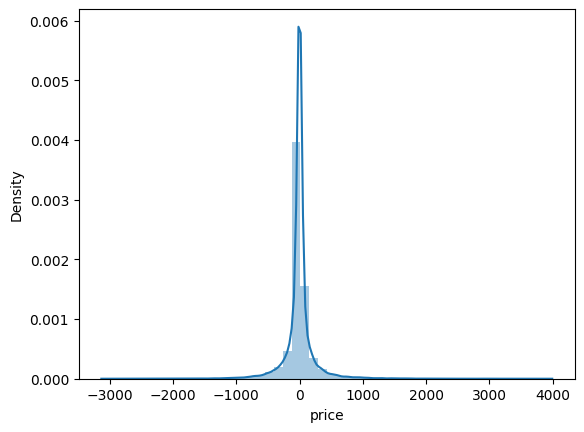

In [233]:
sns.distplot(y_test-prediction)

In [234]:
r2_score(y_test,prediction)

0.80059002745189

[CV] END max_depth=30, max_features=auto, min_samples_split=5, n_estimators=100; total time=  42.6s
[CV] END max_depth=30, max_features=auto, min_samples_split=5, n_estimators=100; total time=  39.7s
[CV] END max_depth=30, max_features=auto, min_samples_split=100, n_estimators=466; total time= 2.4min
